<a href="https://colab.research.google.com/github/fangcharles/ML/blob/main/A3_cluster_1_4_the_nothing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage import io, color, transform, feature, data, exposure, filters
%matplotlib inline

## read and describe the metadata

In [ ]:
fpn_csv = '/Users/ChantsTheRapper/Desktop/ML/A3/cluster_images.csv'
data = pd.read_csv(fpn_csv, encoding='ISO-8859-1')

In [ ]:
# get column names
list(data)

['s_no',
 'artist',
 'title',
 'art_movement',
 'museum_venue',
 'country_of_origin',
 'has_text',
 'primary_medium',
 'medium',
 'work_size',
 'date',
 'representation',
 'representation_semi',
 'kinetic',
 'map',
 'map2',
 'spatial_dimension',
 'spatial_dimension2',
 'pl',
 'si',
 'va',
 'te',
 'co',
 'or',
 'sh',
 'reflection',
 'po',
 'li',
 'ar',
 'notes']

In [ ]:
data.head()

,s_no,artist,title,art_movement,museum_venue,country_of_origin,has_text,primary_medium,medium,work_size,...,va,te,co,or,sh,reflection,po,li,ar,notes
0,2,Giorgio de Chirico,The Uncertainty of the Poet,surrealism,Tate,Italy,False,painting,"painting, oil on canvas",106 x 94 cm,...,3,0,0,4,3,False,0,0,5,"distorted perspective, shadow, signification o..."
1,3,Giovanni Anselmo,Direction,arte povera,Tate,Italy,False,sculpture,"sculpture, fabric, glass & metal",24 x 420 x 335 cm,...,1,3,0,3,2,False,0,0,5,"hard to understand the viewpoint, sense of for..."
2,4,Milton Avery,Yellow Sky,modernism,Tate,America,False,painting,"painting, oil on canvas",156 x 184 cm,...,2,4,4,2,4,False,0,0,5,"flatish, textured shapes & specific colors-lin..."
3,5,Gillian Avery,Distillation,abstraction,Tate,UK,False,painting,"painting, oil, household paint on hardboard",213 x 152 cm,...,1,2,0,2,4,False,0,0,5,"shapes, layers, paint handlng/texture, orienta..."
4,6,Joseph (Jef) Banc,Pair-Bearing Matrix,abstraction,Tate,France,False,painting,"painting, mixed media on canvas",73 x 60 cm,...,1,4,1,0,4,False,0,0,5,"ambiguity through abstraction, odd shape, v te..."


## create a subset of the columns you will use to fit KMeans

Here, I am **arbitrarily** choosing the seven [visual variables defined by Bertin](https://infovis-wiki.net/wiki/Visual_Variables). Variable descriptions [here](https://github.com/visualizedata/ml/blob/master/ML_assignment_3/option_2/contents-of-cluster_images.csv). 

You should choose the columns that you decide will best define the clusters. You may need to make transformations on existing variables. 

In [ ]:
X = data[['pl', 'si', 'va', 'te', 'co', 'or', 'sh', 'po', 'li', 'ar']]

In [ ]:
X.head()

,pl,si,va,te,co,or,sh,po,li,ar
0,2,2,3,0,0,4,3,0,0,5
1,4,3,1,3,0,3,2,0,0,5
2,3,0,2,4,4,2,4,0,0,5
3,4,3,1,2,0,2,4,0,0,5
4,1,0,1,4,1,0,4,0,0,5


# KMeans

In [ ]:
from sklearn.cluster import KMeans

## plot inertia scores by number of clusters

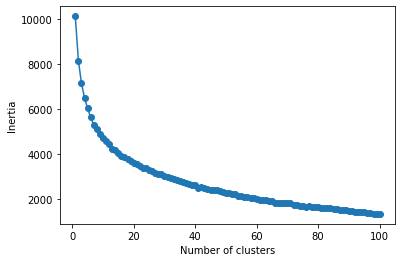

In [ ]:
# first attempt at fitting K means to view change in Inertia

# container to store inertia scores over iterations
distortions = []

# fit KMeans iteratively to begin to assess the appropriate number of clusters
for i in range(1, 101):
    km = KMeans(n_clusters=i)
    km.fit(X)
    distortions.append(km.inertia_)
    
# vizualize change in inertia
plt.plot(range(1, 101), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

## create silhouette plots to assess various specifications for `n_clusters` in `KMeans`

In [ ]:
# modify this list to include the numbers of clusters you want to see
# I have *arbitrarily* chosen these values
range_n_clusters = [5, 10, 15, 20, 25]

For n_clusters = 5 The average silhouette_score is : 0.16542347570726432


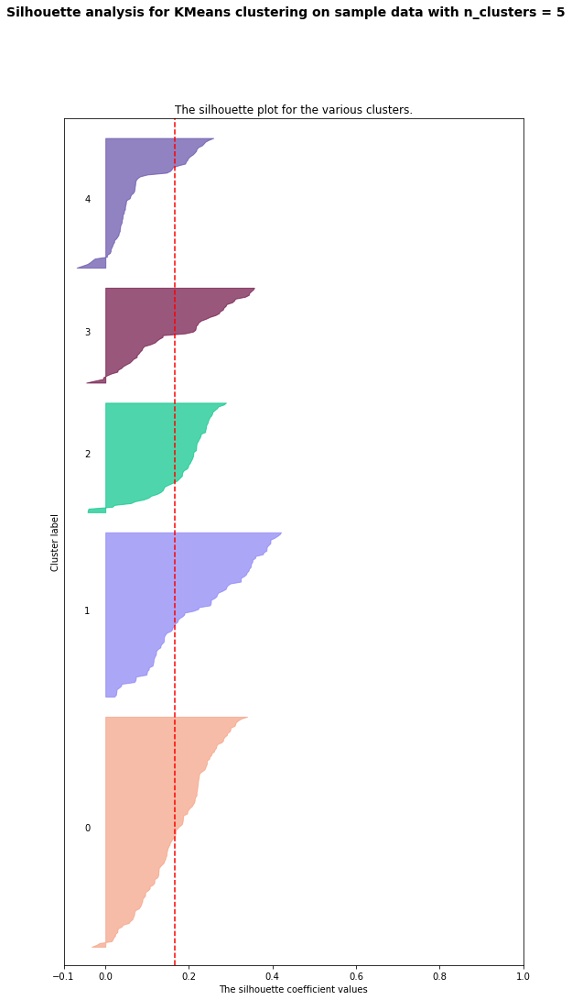

For n_clusters = 10 The average silhouette_score is : 0.16159131703724666


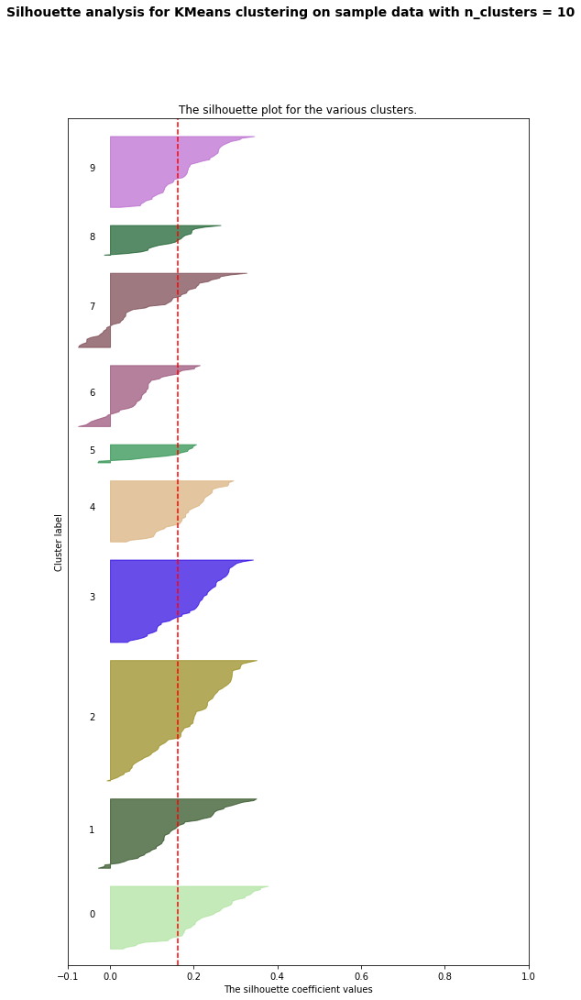

For n_clusters = 15 The average silhouette_score is : 0.15290395812065066


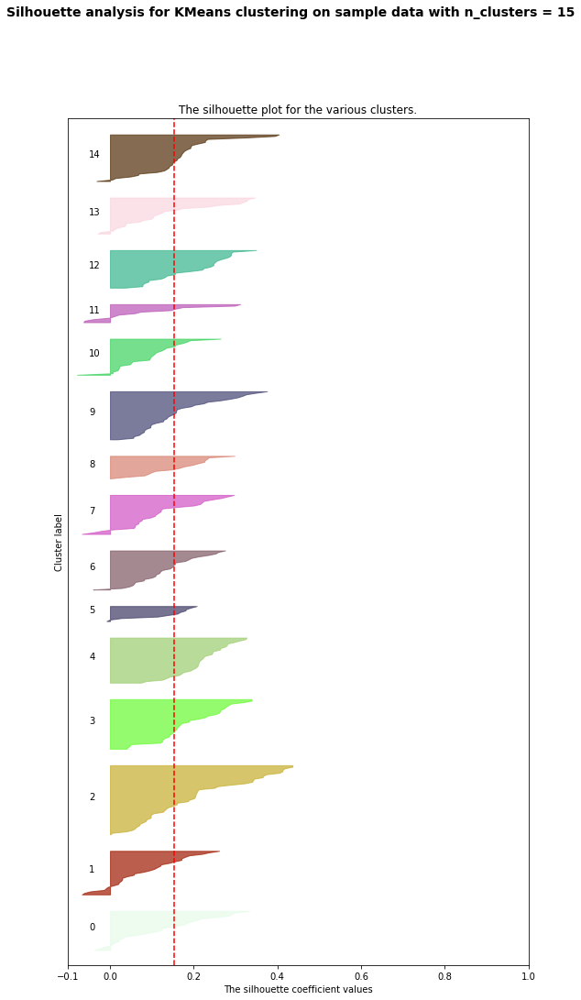

For n_clusters = 20 The average silhouette_score is : 0.1436401735672295


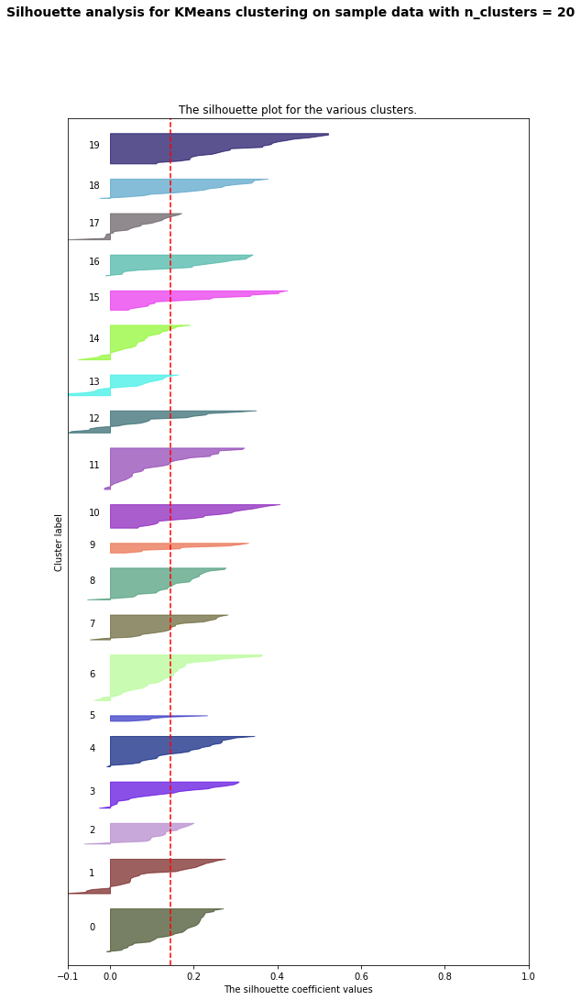

For n_clusters = 25 The average silhouette_score is : 0.17140123102691804


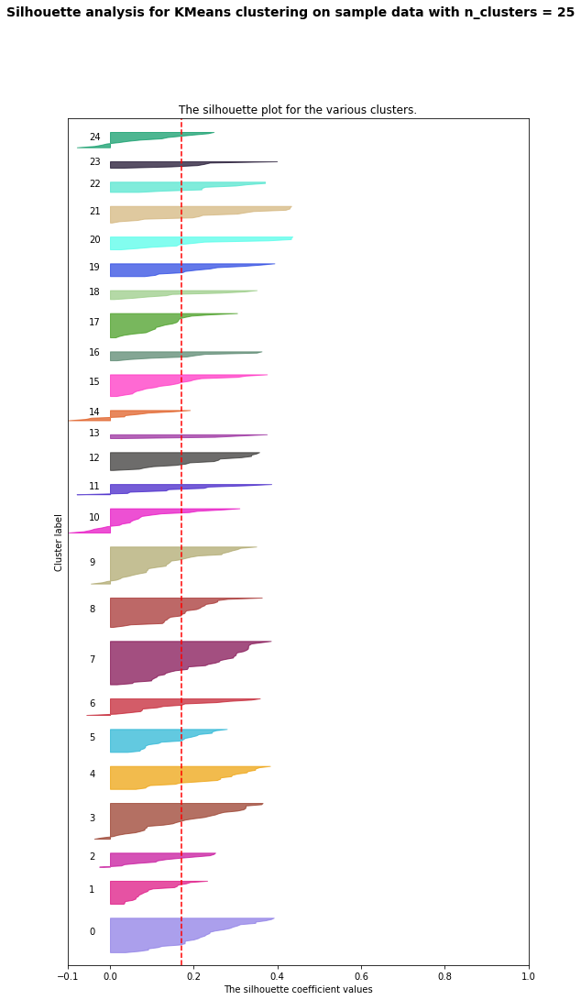

In [ ]:
# modified from: http://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html

from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm
import random

for n_clusters in range_n_clusters:
    # Create a subplot
    fig, (ax1) = plt.subplots(1, 1)
    fig.set_size_inches(9, 17)

    # The silhouette coefficient can range from -1, 1 but in this example all lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters, "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        # select a random color for this cluster
        r = lambda: random.randint(0,255)
        color = '#%02X%02X%02X' % (r(),r(),r())
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

    plt.show()

## final fit

After you have decided which features to include and the number of clusters you want, fit your final KMeans model. I have **arbitrarily** chosen 5. 

In [ ]:
# set the number of clusters in the final model
my_n_clusters = 10

In [ ]:
km = KMeans(n_clusters=my_n_clusters)
km.fit(X)

KMeans(n_clusters=10)

## look at results

The key to knowing if you have chosen the right features and clusters: looking at the images in each cluster and deciding whether they seem to belong together. You could extend this starter code to display the images in this notebook, or you may decide to use Python to write an html file/files to view the images by cluster.

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 0
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
17_small.jpg


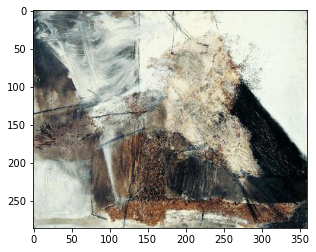

20_small.jpg


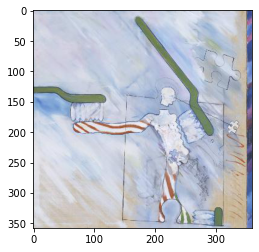

40_small.jpg


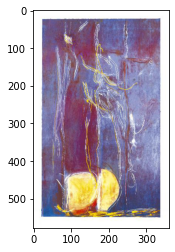

42_small.jpg


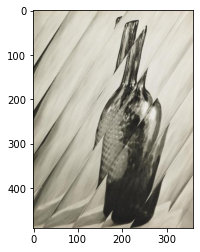

48_small.jpg


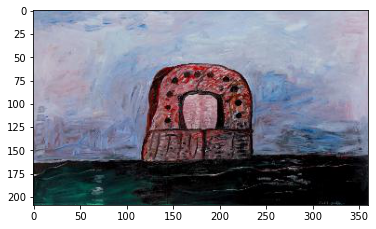

51_small.jpg


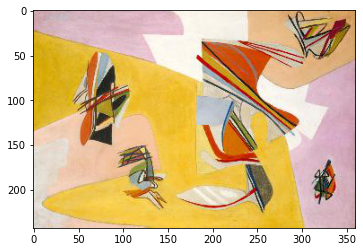

60_small.jpg


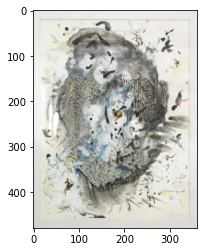

86_small.jpg


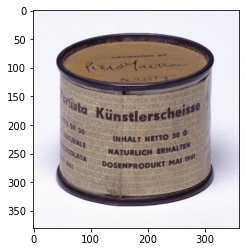

101_small.jpg


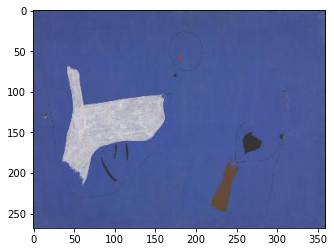

109_small.jpg


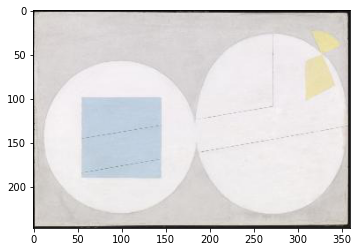

114_small.jpg


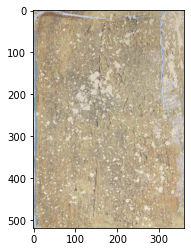

116_small.jpg


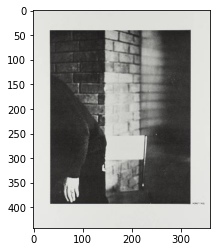

118_small.jpg


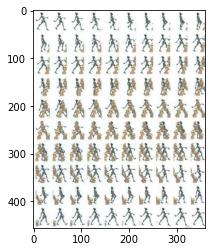

123_small.jpg


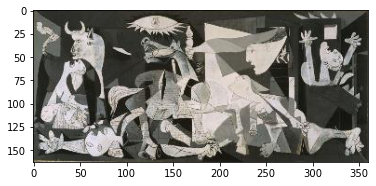

132_small.jpg


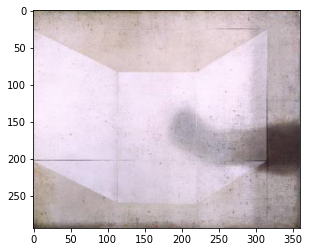

134_small.jpg


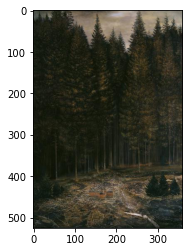

153_small.jpg


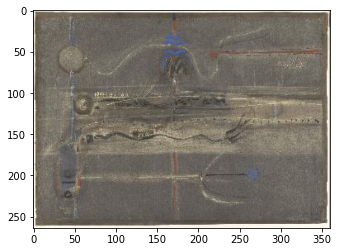

156_small.jpg


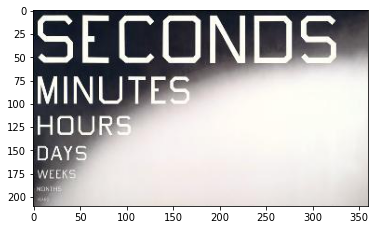

175_small.jpg


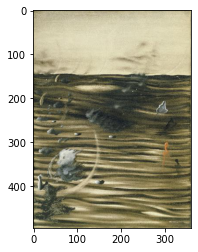

184_small.jpg


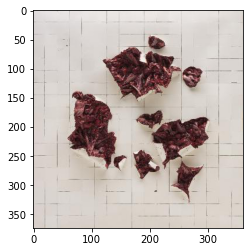

186_small.jpg


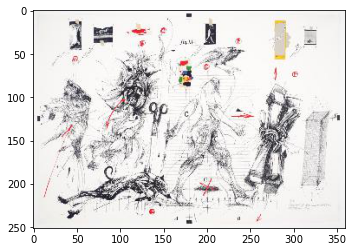

187_small.jpg


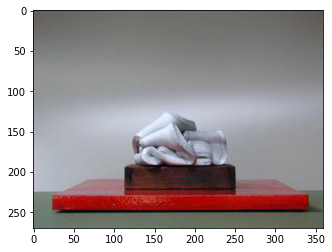

189_small.jpg


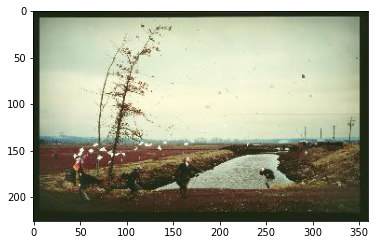

207_small.jpg


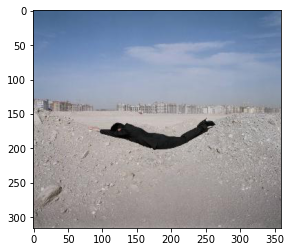

210_small.jpg


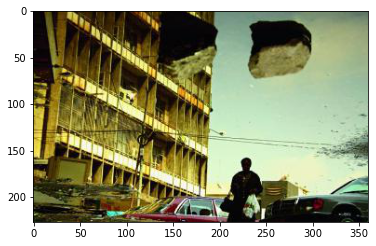

216_small.jpg


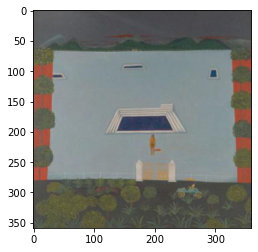

217_small.jpg


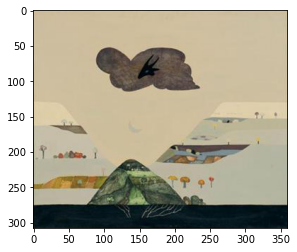

226_small.jpg


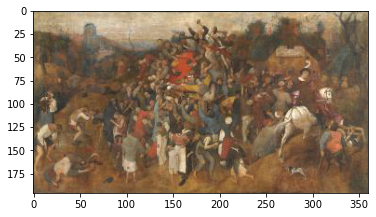

231_small.jpg


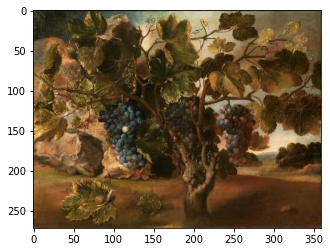

232_small.jpg


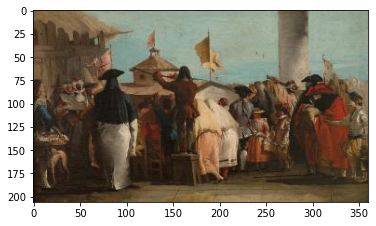

238_small.jpg


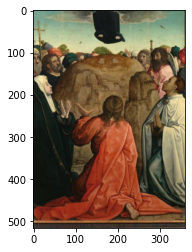

239_small.jpg


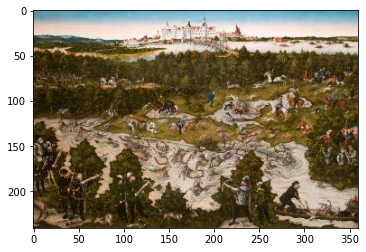

245_small.jpg


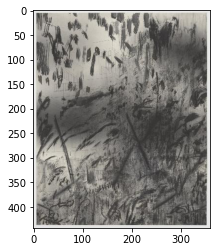

248_small.jpg


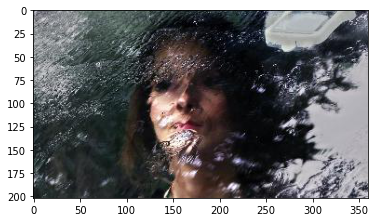

250_small.jpg


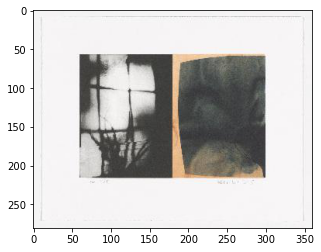

251_small.jpg


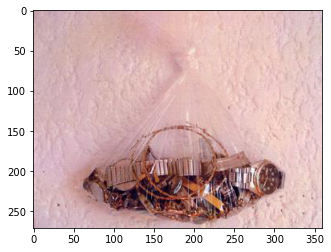

255_small.jpg


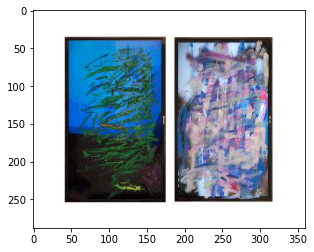

256_small.jpg


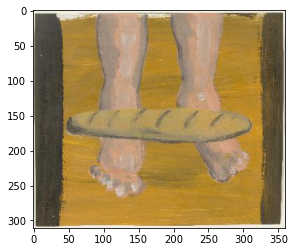

259_small.jpg


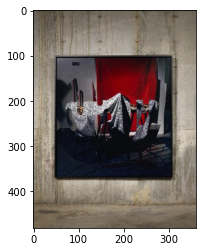

262_small.jpg


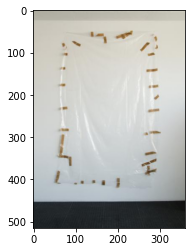

264_small.jpg


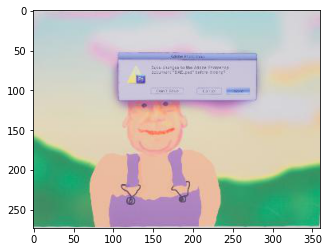

266_small.jpg


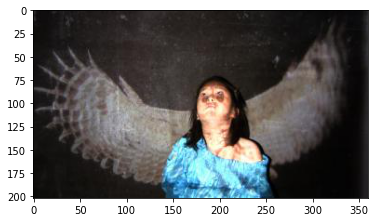

271_small.jpg


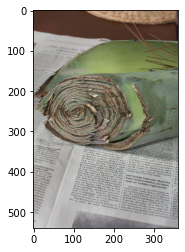

286_small.jpg


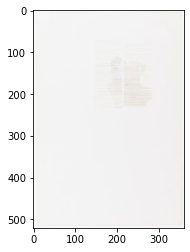

334_small.jpg


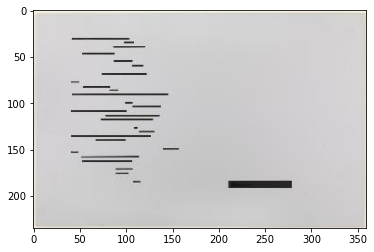

337_small.jpg


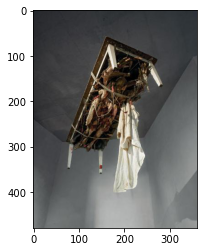

340_small.jpg


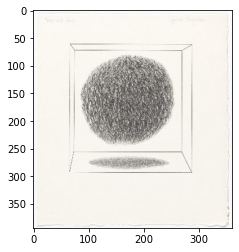

346_small.jpg


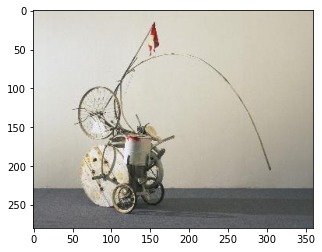

349_small.jpg


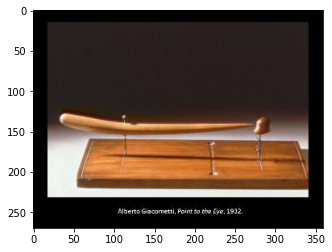

351_small.jpg


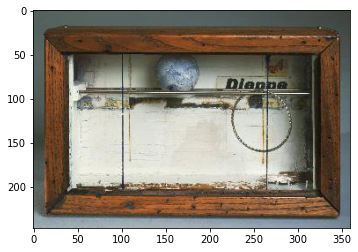

359_small.jpg


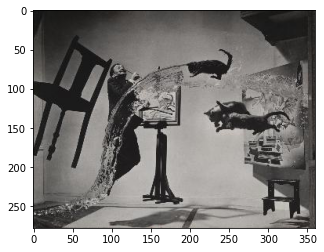

368_small.jpg


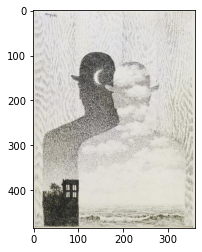

374_small.jpg


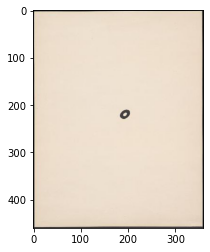

381_small.jpg


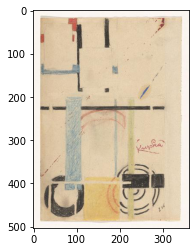

389_small.jpg


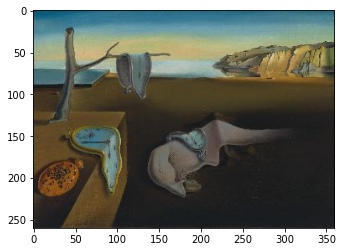

397_small.jpg


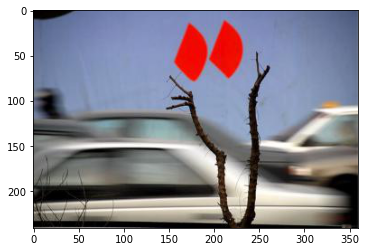

399_small.jpg


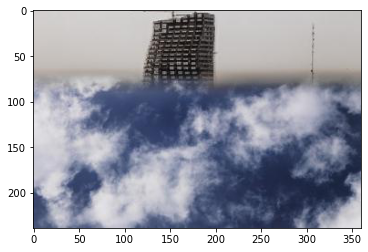

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 1
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
2_small.jpg


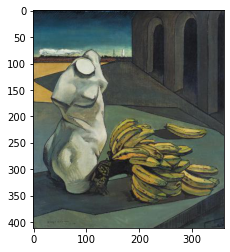

3_small.jpg


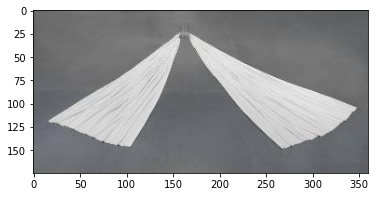

8_small.jpg


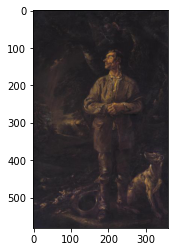

12_small.jpg


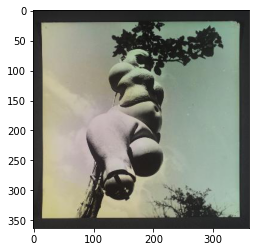

33_small.jpg


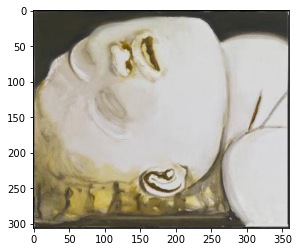

43_small.jpg


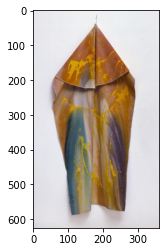

52_small.jpg


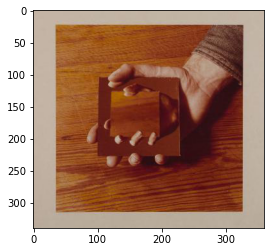

77_small.jpg


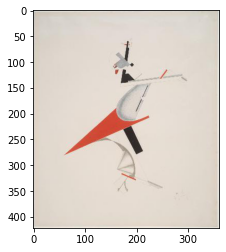

80_small.jpg


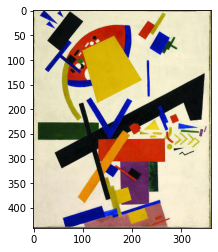

90_small.jpg


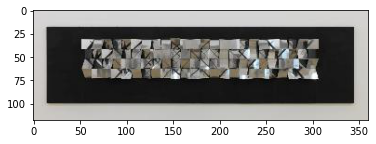

91_small.jpg


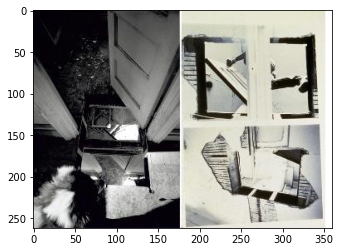

97_small.jpg


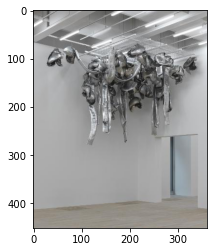

100_small.jpg


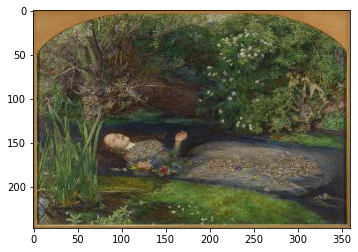

112_small.jpg


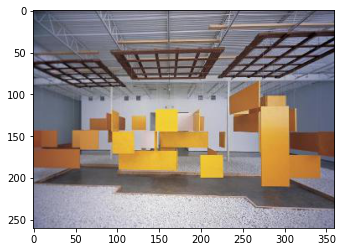

137_small.jpg


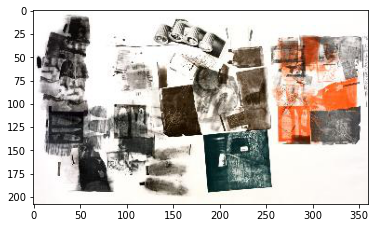

139_small.jpg


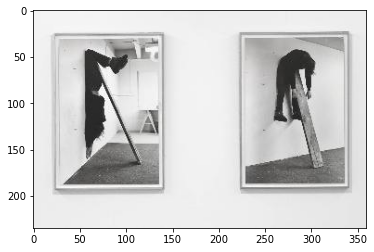

157_small.jpg


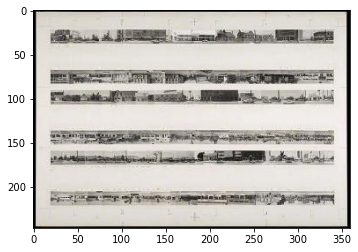

162_small.jpg


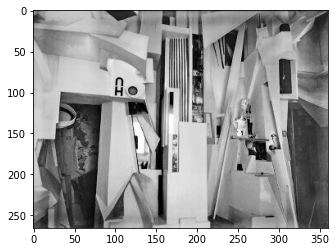

163_small.jpg


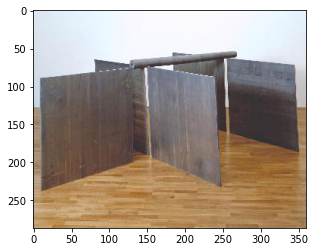

168_small.jpg


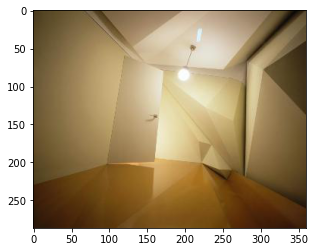

170_small.jpg


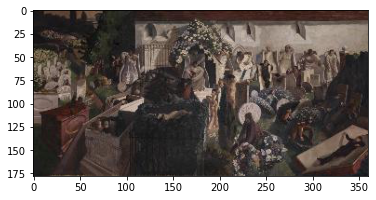

171_small.jpg


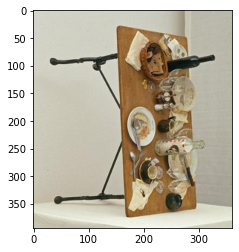

190_small.jpg


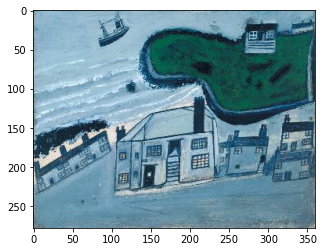

205_small.jpg


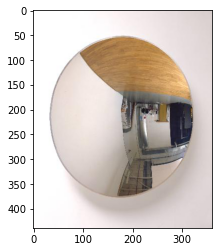

233_small.jpg


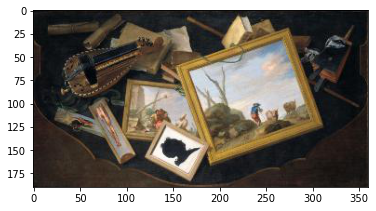

281_small.jpg


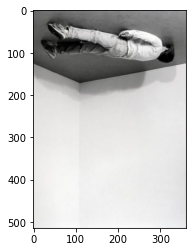

295_small.jpg


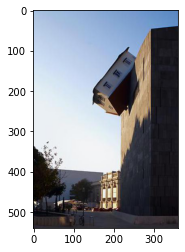

306_small.jpg


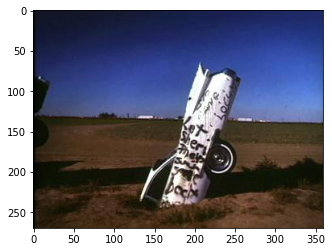

333_small.jpg


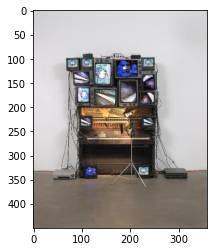

358_small.jpg


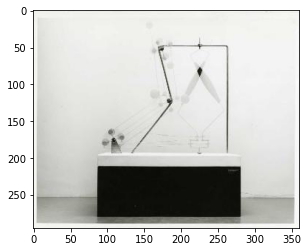

378_small.jpg


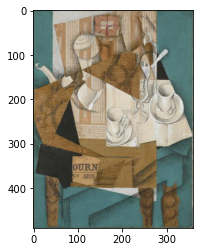

392_small.jpg


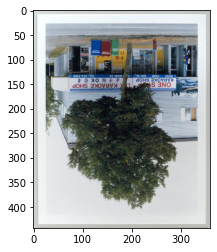

403_small.jpg


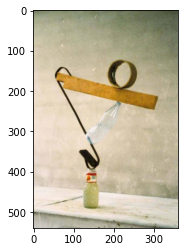

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 2
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
37_small.jpg


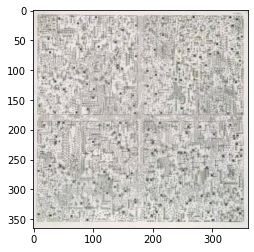

62_small.jpg


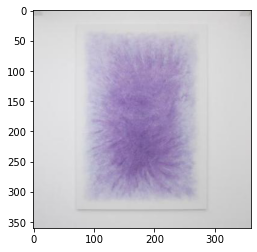

96_small.jpg


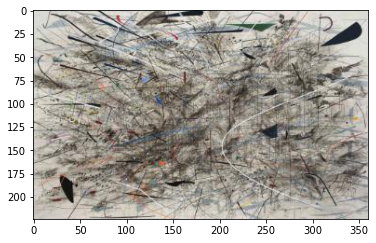

111_small.jpg


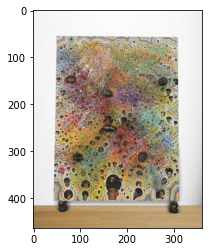

127_small.jpg


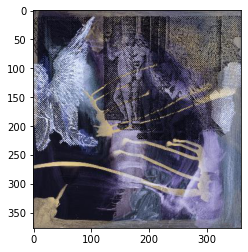

129_small.jpg


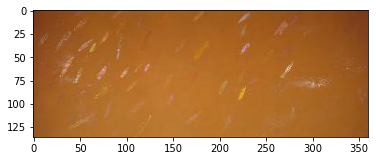

135_small.jpg


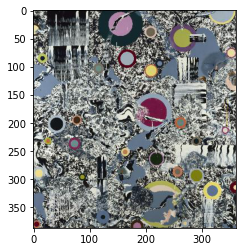

146_small.jpg


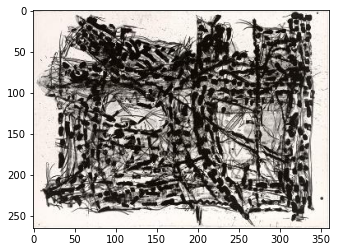

150_small.jpg


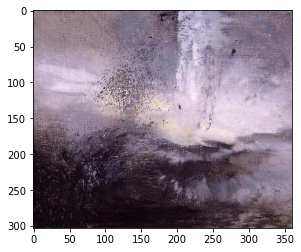

154_small.jpg


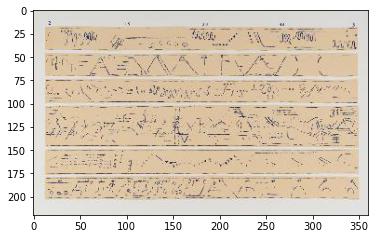

165_small.jpg


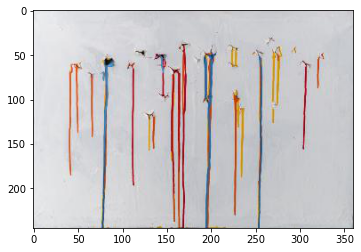

174_small.jpg


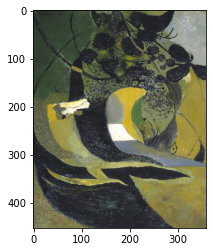

179_small.jpg


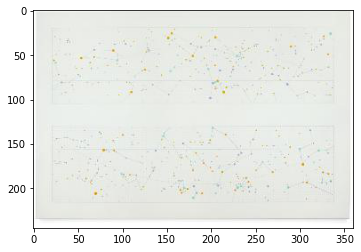

188_small.jpg


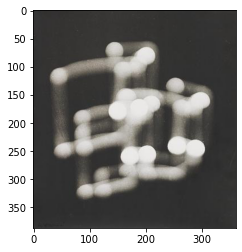

193_small.jpg


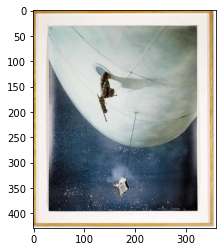

227_small.jpg


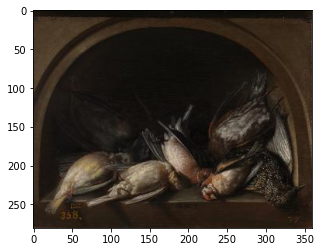

252_small.jpg


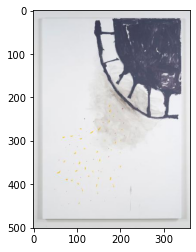

261_small.jpg


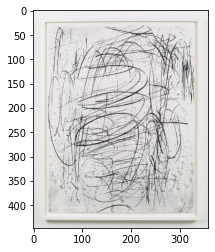

263_small.jpg


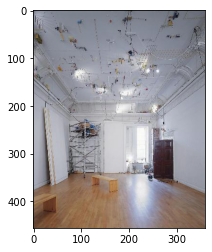

288_small.jpg


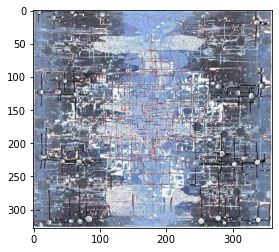

292_small.jpg


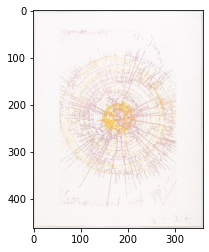

293_small.jpg


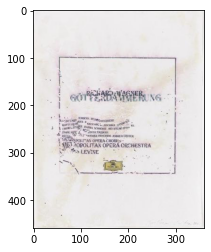

294_small.jpg


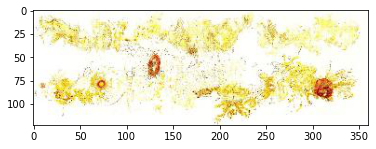

300_small.jpg


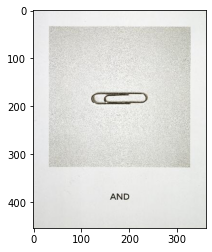

304_small.jpg


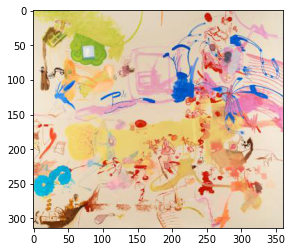

305_small.jpg


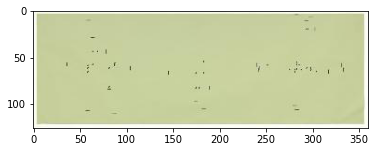

308_small.jpg


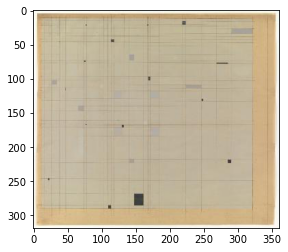

320_small.jpg


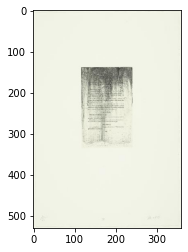

330_small.jpg


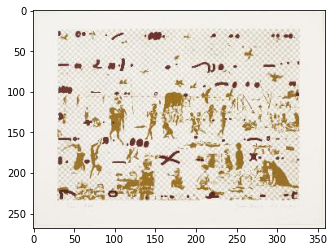

338_small.jpg


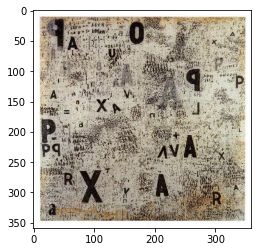

356_small.jpg


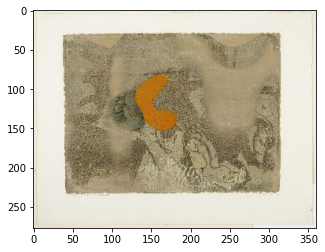

361_small.jpg


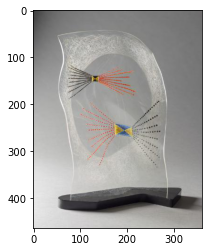

370_small.jpg


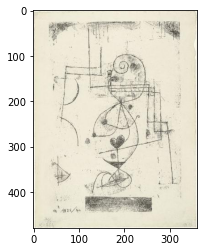

371_small.jpg


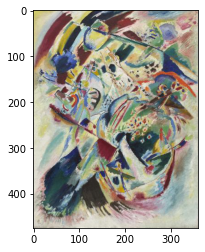

372_small.jpg


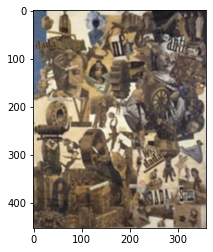

377_small.jpg


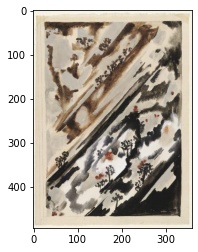

382_small.jpg


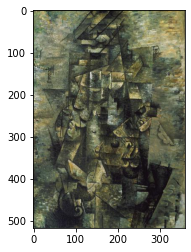

393_small.jpg


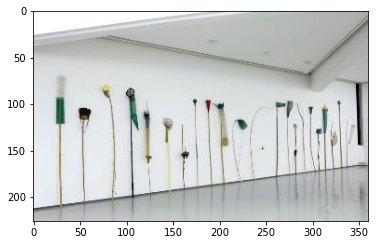

394_small.jpg


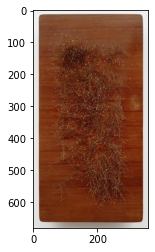

396_small.jpg


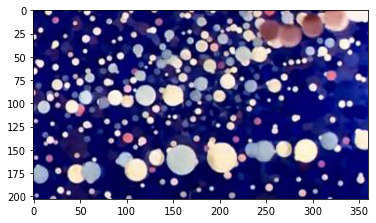

398_small.jpg


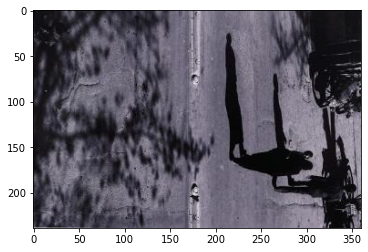

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 3
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
7_small.jpg


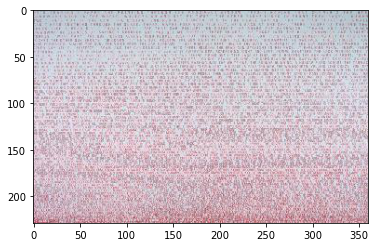

10_small.jpg


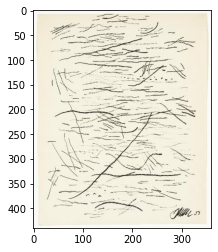

18_small.jpg


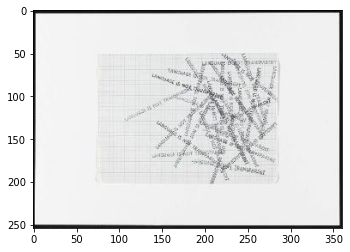

47_small.jpg


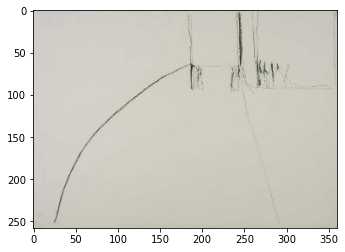

55_small.jpg


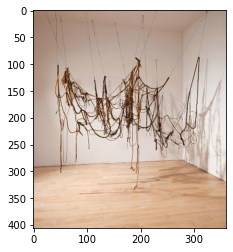

61_small.jpg


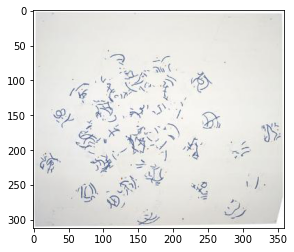

67_small.jpg


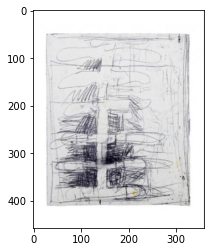

75_small.jpg


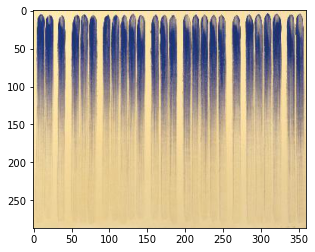

81_small.jpg


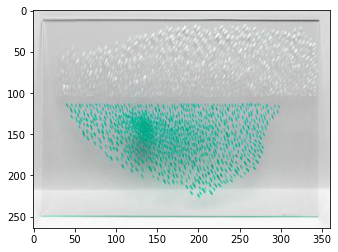

87_small.jpg


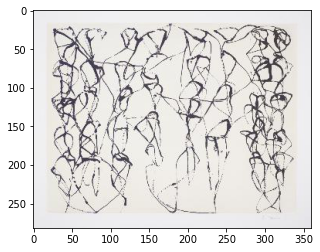

89_small.jpg


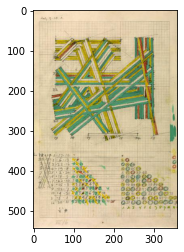

102_small.jpg


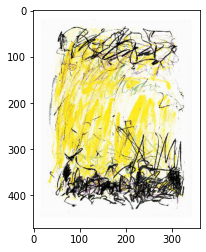

136_small.jpg


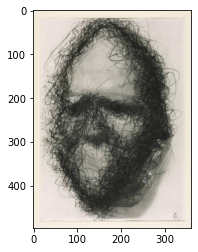

145_small.jpg


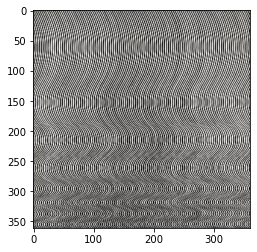

151_small.jpg


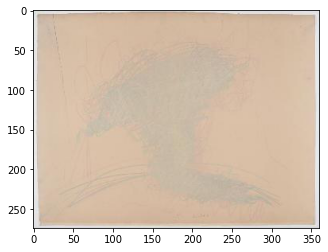

155_small.jpg


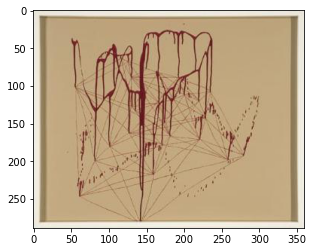

159_small.jpg


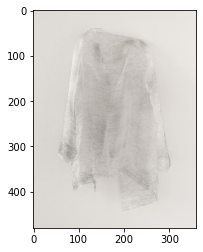

160_small.jpg


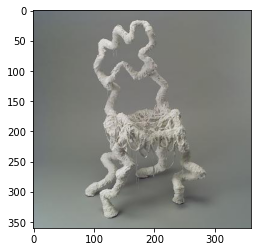

173_small.jpg


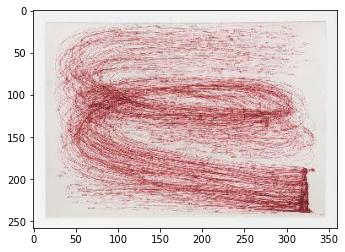

177_small.jpg


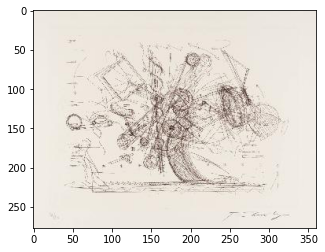

180_small.jpg


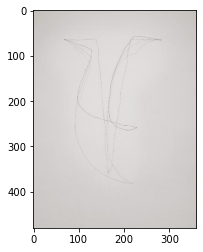

183_small.jpg


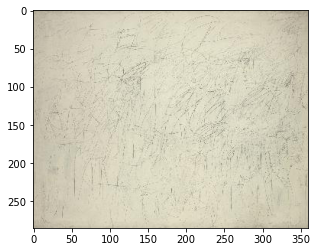

196_small.jpg


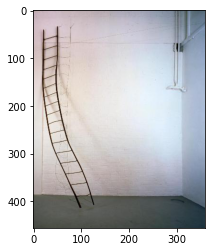

201_small.jpg


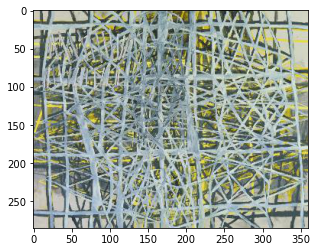

202_small.jpg


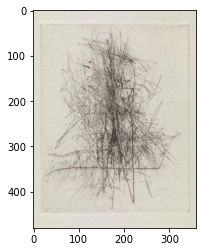

219_small.jpg


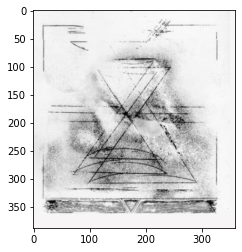

220_small.jpg


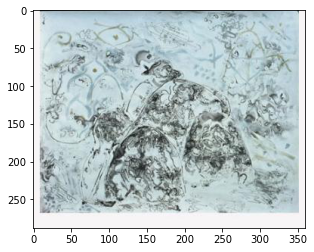

237_small.jpg


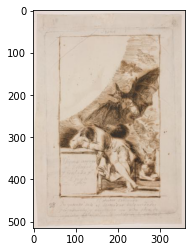

242_small.jpg


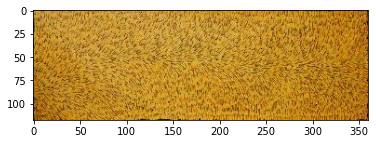

243_small.jpg


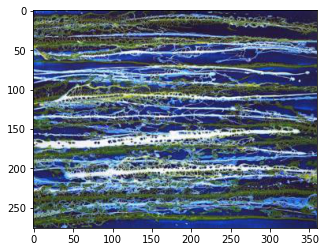

246_small.jpg


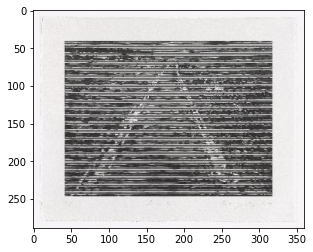

249_small.jpg


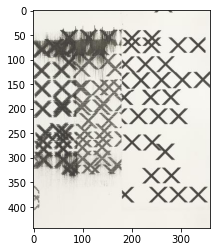

253_small.jpg


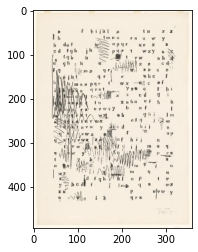

276_small.jpg


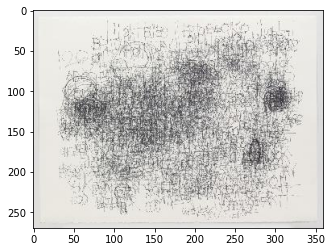

279_small.jpg


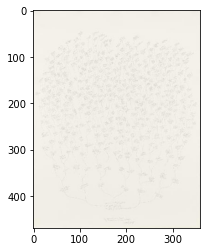

298_small.jpg


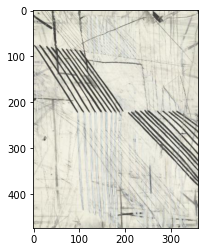

310_small.jpg


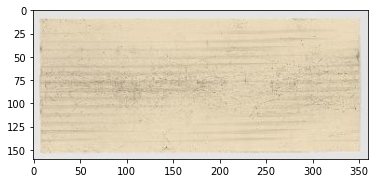

313_small.jpg


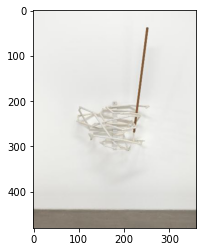

314_small.jpg


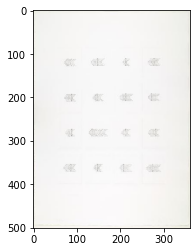

316_small.jpg


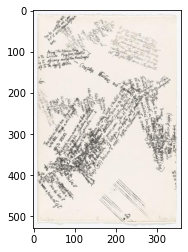

317_small.jpg


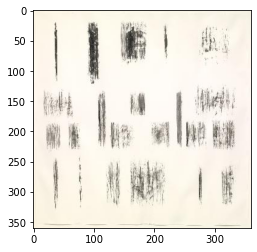

321_small.jpg


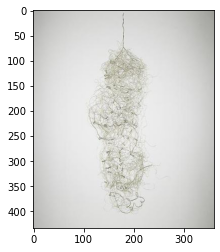

322_small.jpg


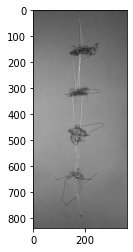

324_small.jpg


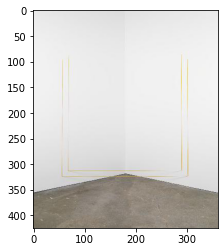

332_small.jpg


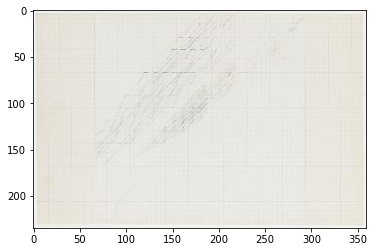

341_small.jpg


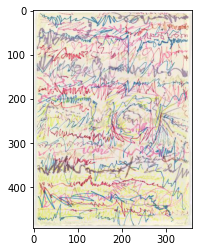

345_small.jpg


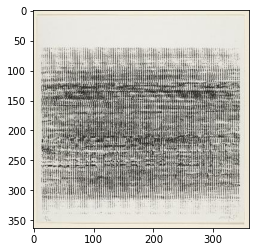

347_small.jpg


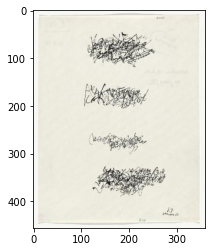

353_small.jpg


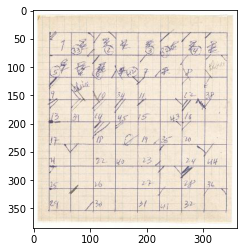

395_small.jpg


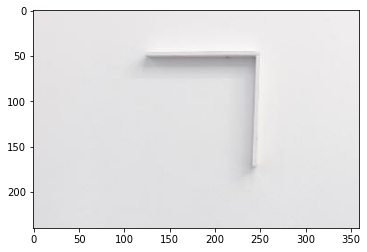

401_small.jpg


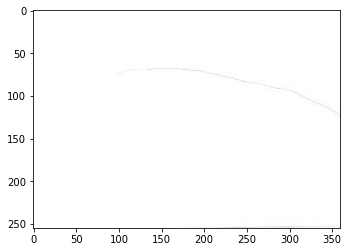

402_small.jpg


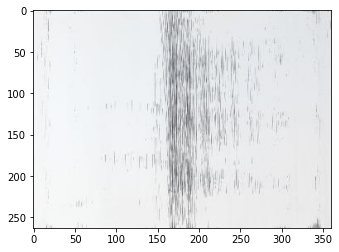

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 4
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
11_small.jpg


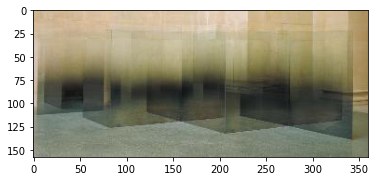

14_small.jpg


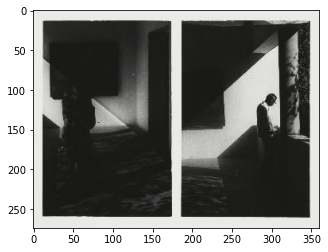

16_small.jpg


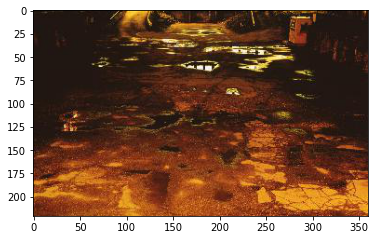

19_small.jpg


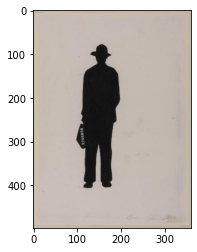

26_small.jpg


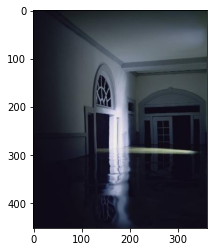

30_small.jpg


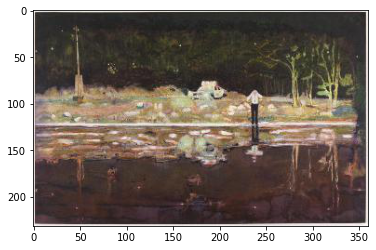

69_small.jpg


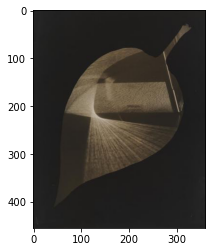

98_small.jpg


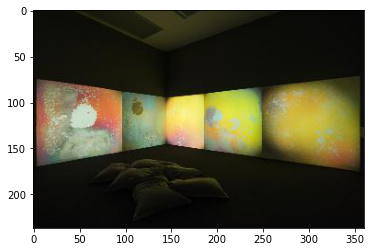

141_small.jpg


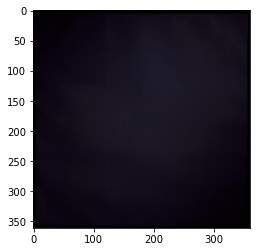

142_small.jpg


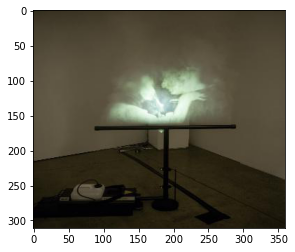

176_small.jpg


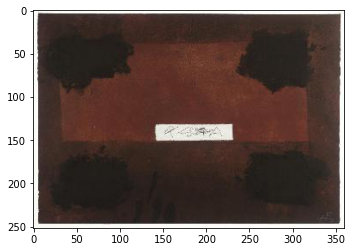

191_small.jpg


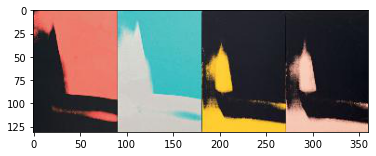

192_small.jpg


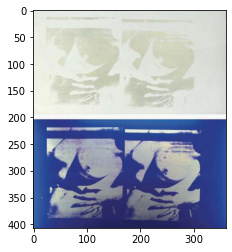

195_small.jpg


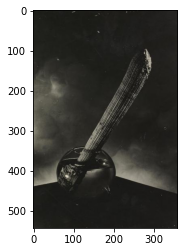

197_small.jpg


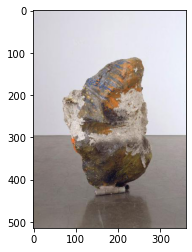

203_small.jpg


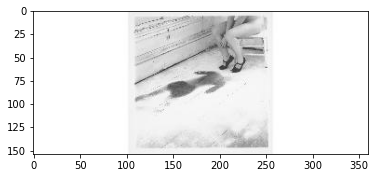

208_small.jpg


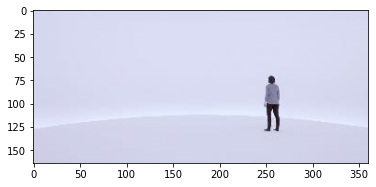

213_small.jpg


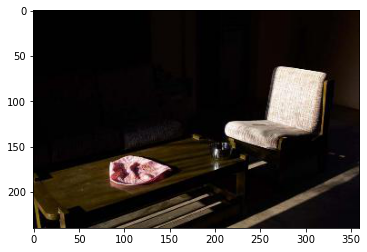

267_small.jpg


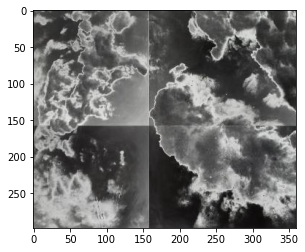

269_small.jpg


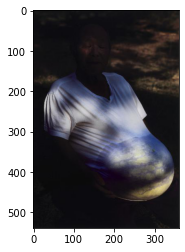

284_small.jpg


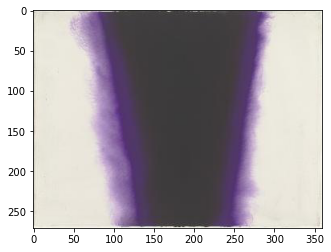

307_small.jpg


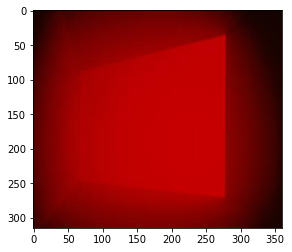

315_small.jpg


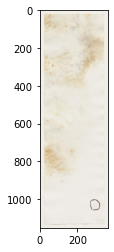

325_small.jpg


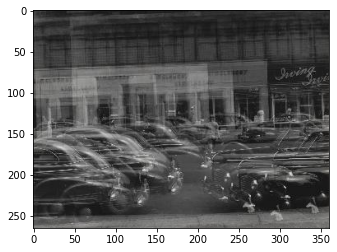

362_small.jpg


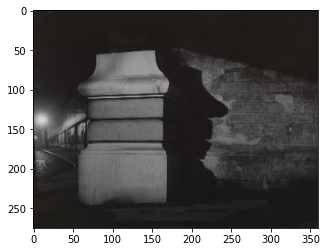

364_small.jpg


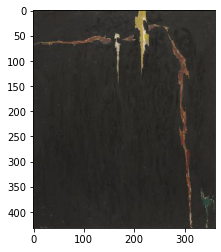

367_small.jpg


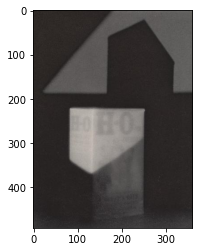

369_small.jpg


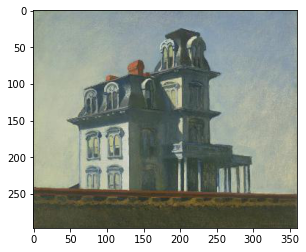

375_small.jpg


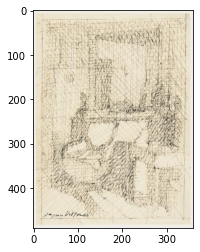

376_small.jpg


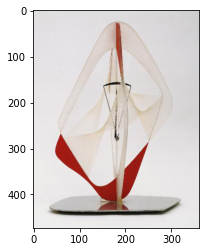

384_small.jpg


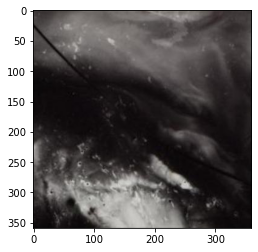

388_small.jpg


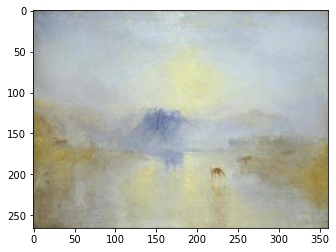

390_small.jpg


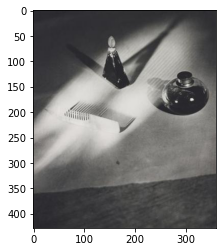

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 5
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
13_small.jpg


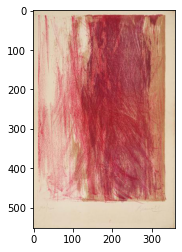

22_small.jpg


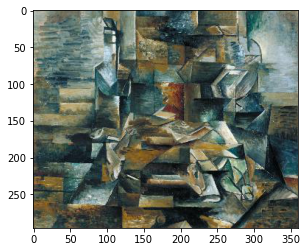

24_small.jpg


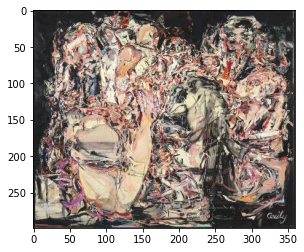

28_small.jpg


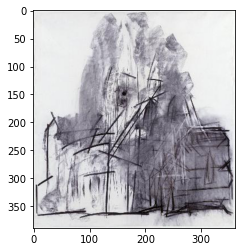

29_small.jpg


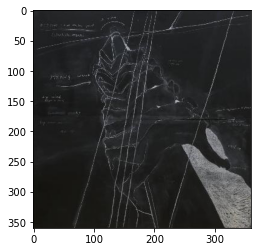

39_small.jpg


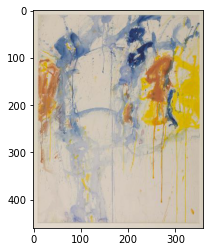

45_small.jpg


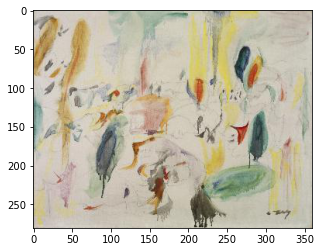

46_small.jpg


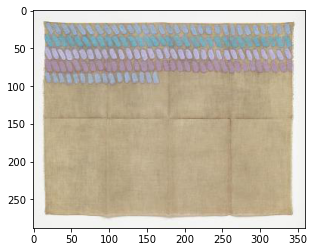

49_small.jpg


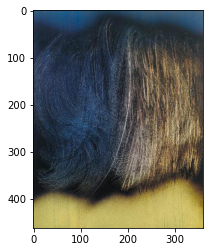

53_small.jpg


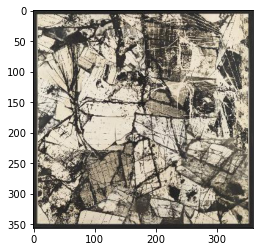

65_small.jpg


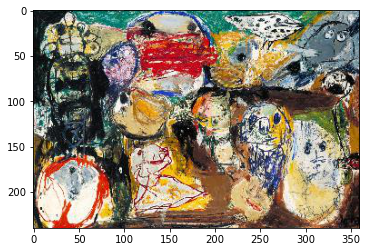

72_small.jpg


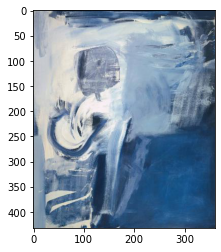

74_small.jpg


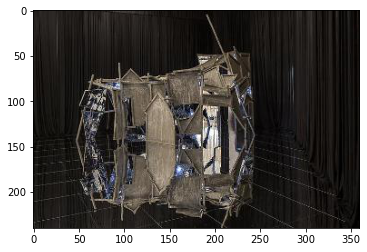

83_small.jpg


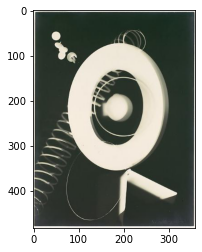

88_small.jpg


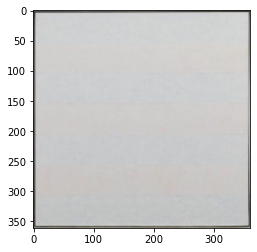

108_small.jpg


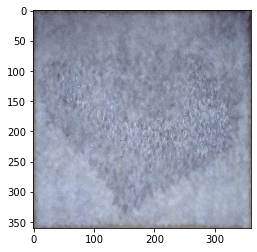

110_small.jpg


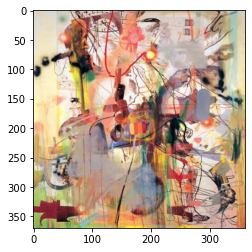

122_small.jpg


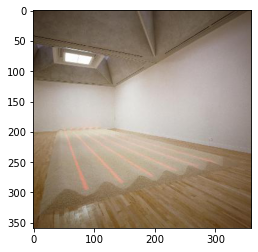

125_small.jpg


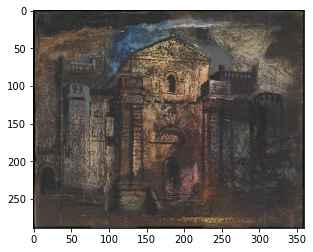

138_small.jpg


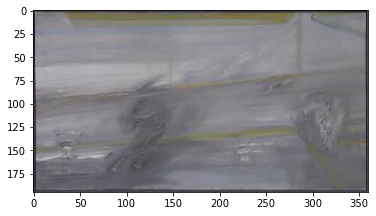

144_small.jpg


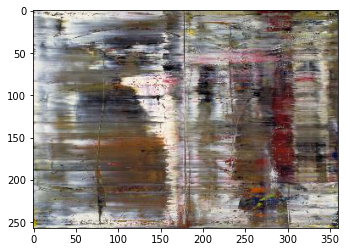

147_small.jpg


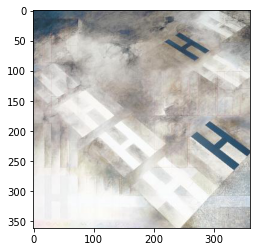

149_small.jpg


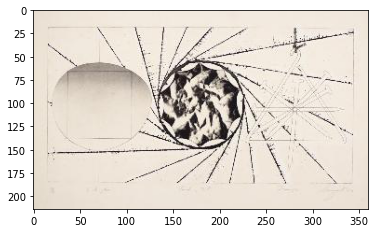

152_small.jpg


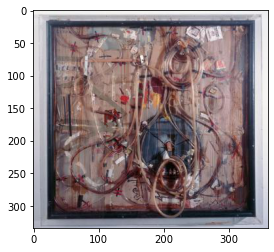

169_small.jpg


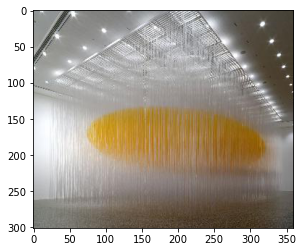

182_small.jpg


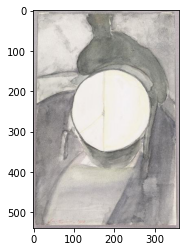

194_small.jpg


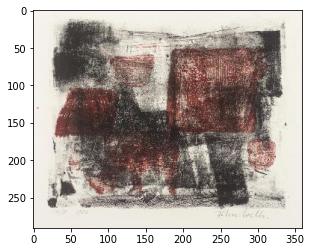

200_small.jpg


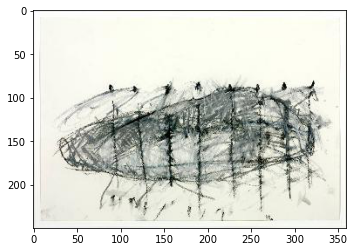

206_small.jpg


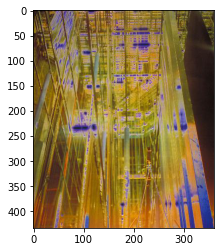

218_small.jpg


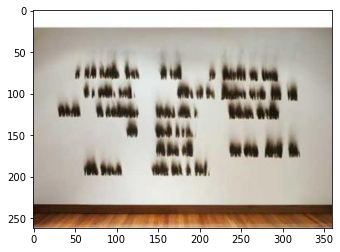

236_small.jpg


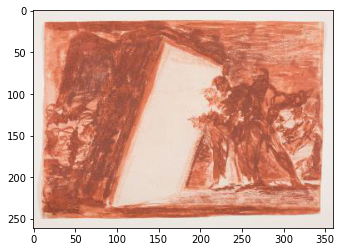

240_small.jpg


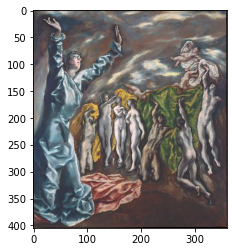

244_small.jpg


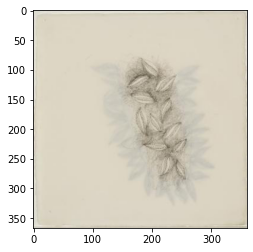

257_small.jpg


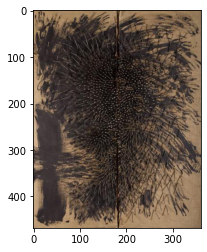

258_small.jpg


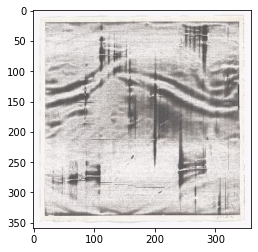

260_small.jpg


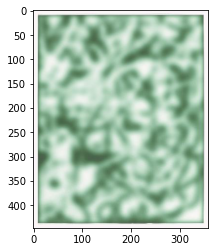

268_small.jpg


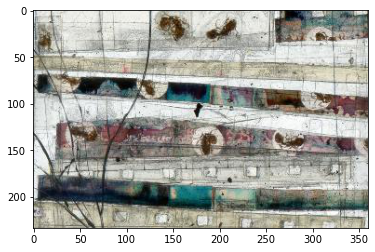

270_small.jpg


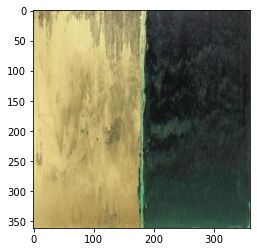

272_small.jpg


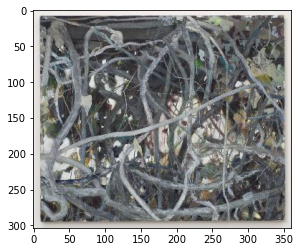

273_small.jpg


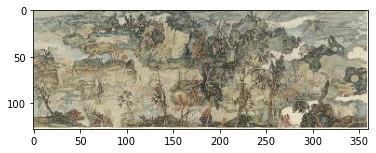

274_small.jpg


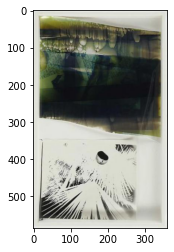

282_small.jpg


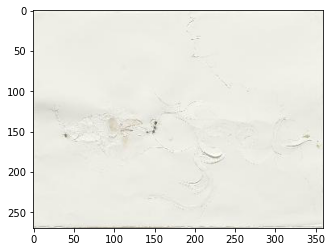

283_small.jpg


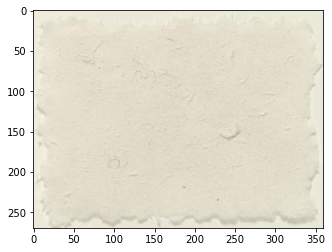

285_small.jpg


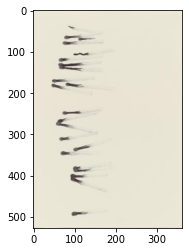

302_small.jpg


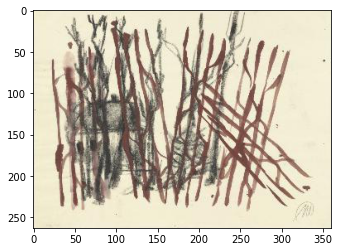

303_small.jpg


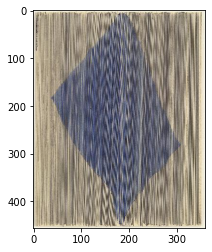

309_small.jpg


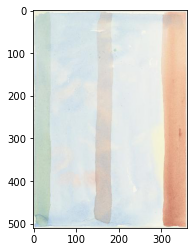

311_small.jpg


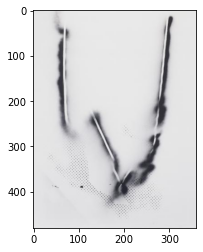

312_small.jpg


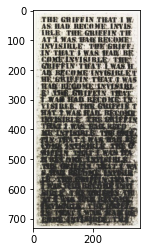

318_small.jpg


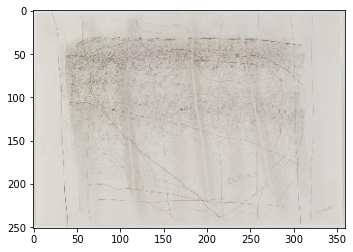

327_small.jpg


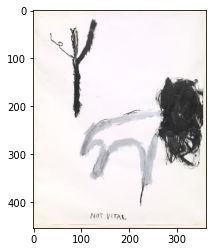

331_small.jpg


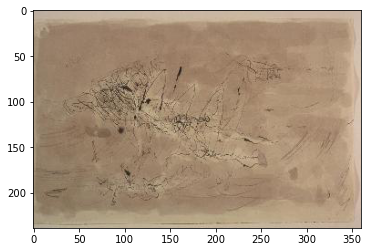

336_small.jpg


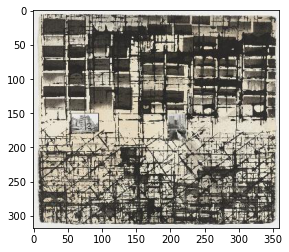

339_small.jpg


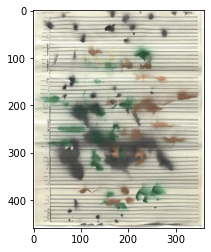

342_small.jpg


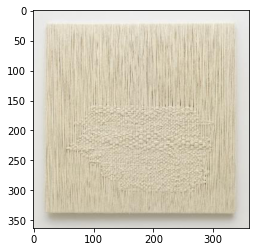

354_small.jpg


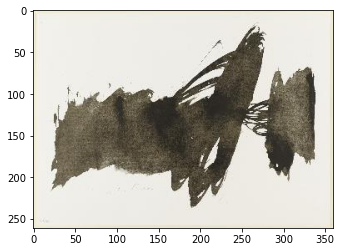

360_small.jpg


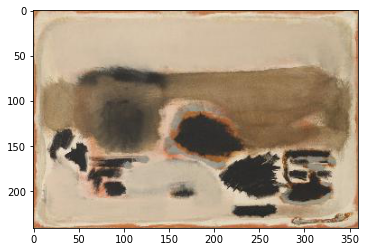

379_small.jpg


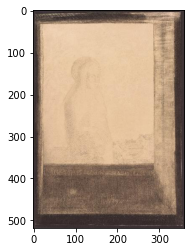

383_small.jpg


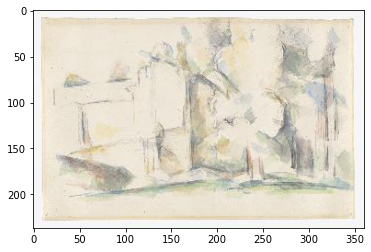

391_small.jpg


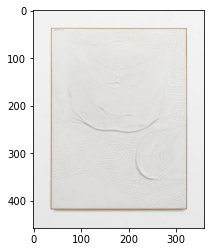

400_small.jpg


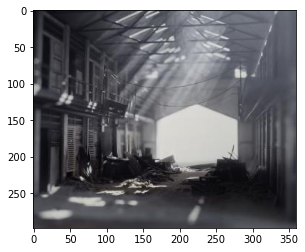

404_small.jpg


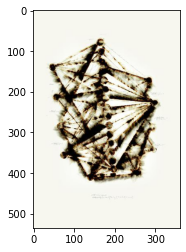

405_small.jpg


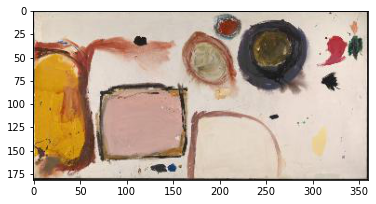

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 6
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
4_small.jpg


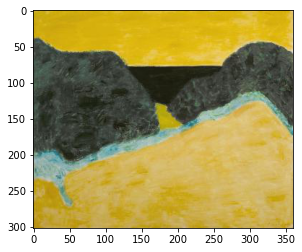

6_small.jpg


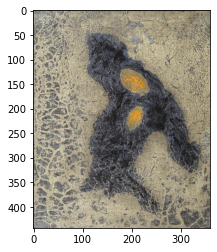

9_small.jpg


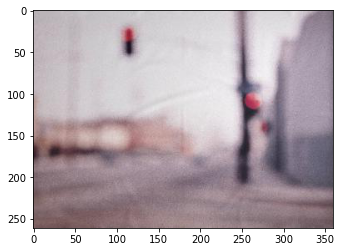

15_small.jpg


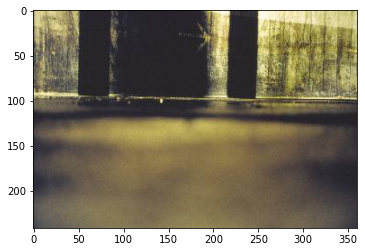

25_small.jpg


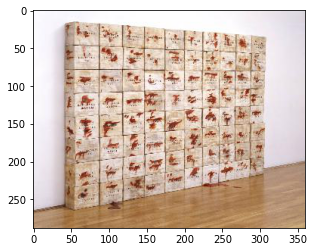

27_small.jpg


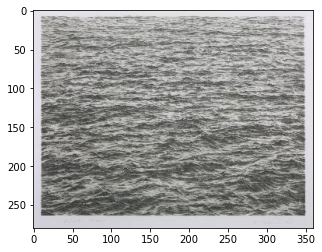

36_small.jpg


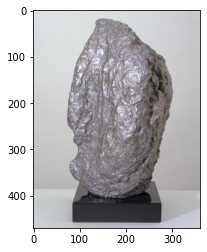

94_small.jpg


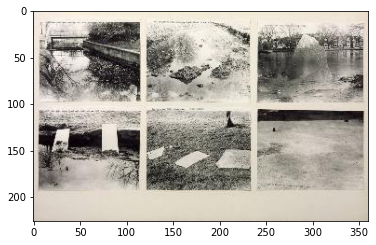

95_small.jpg


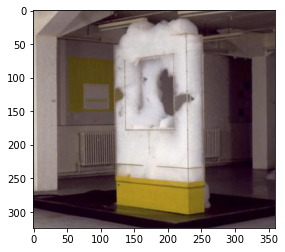

107_small.jpg


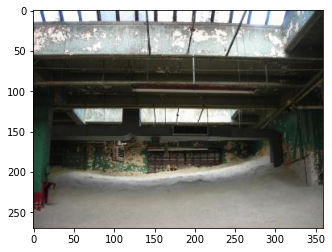

119_small.jpg


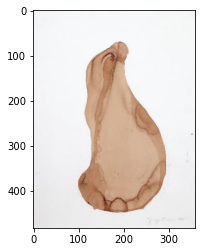

166_small.jpg


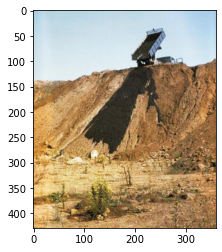

167_small.jpg


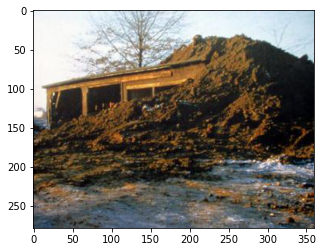

199_small.jpg


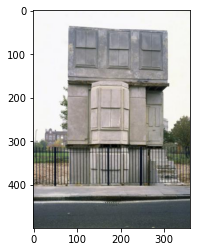

224_small.jpg


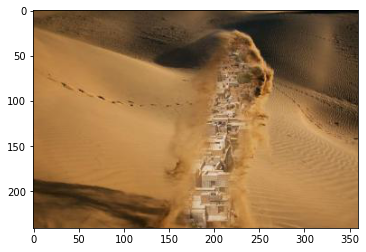

254_small.jpg


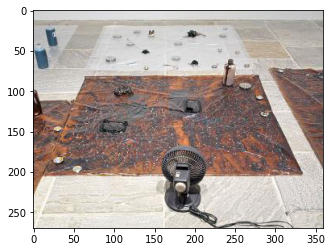

265_small.jpg


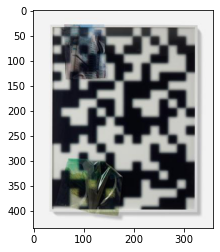

280_small.jpg


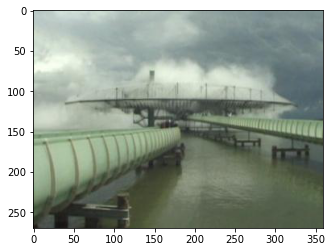

323_small.jpg


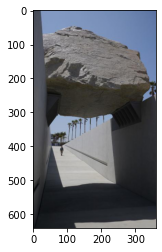

343_small.jpg


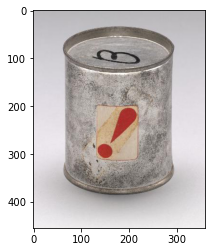

366_small.jpg


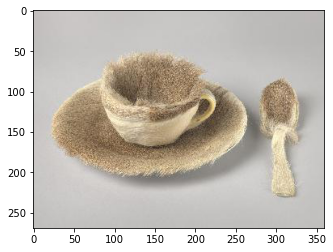

385_small.jpg


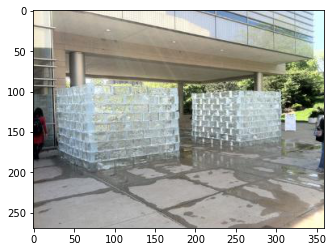

387_small.jpg


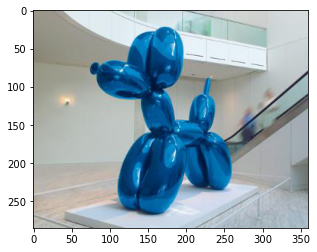

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 7
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
31_small.jpg


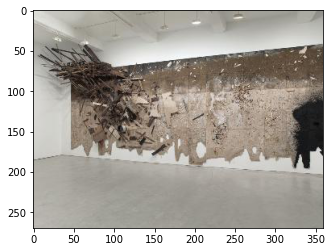

35_small.jpg


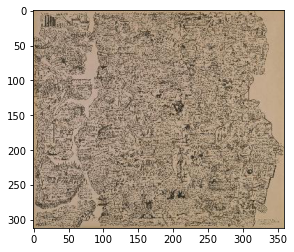

44_small.jpg


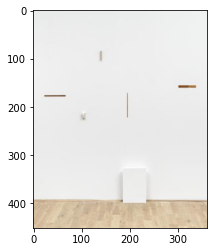

54_small.jpg


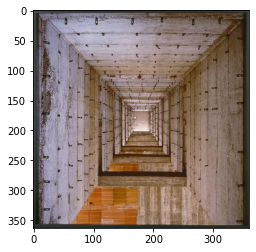

56_small.jpg


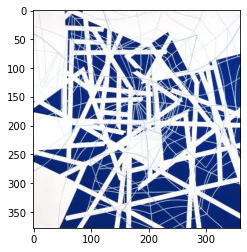

57_small.jpg


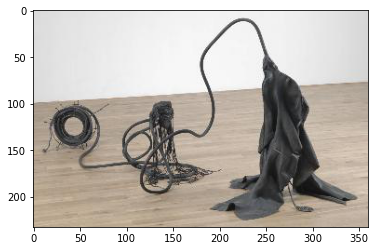

59_small.jpg


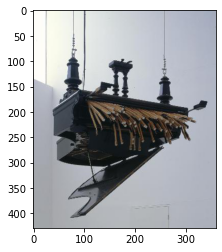

63_small.jpg


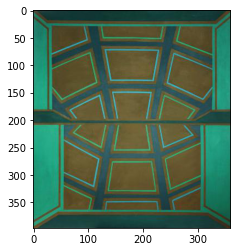

68_small.jpg


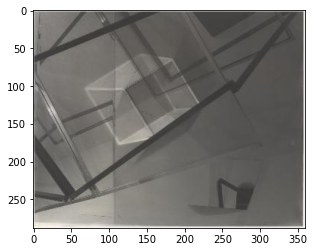

73_small.jpg


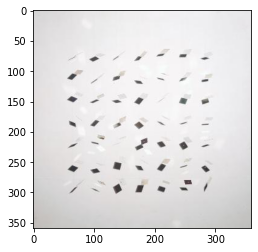

78_small.jpg


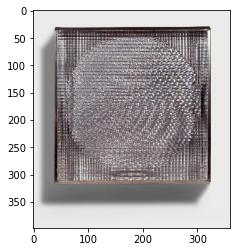

99_small.jpg


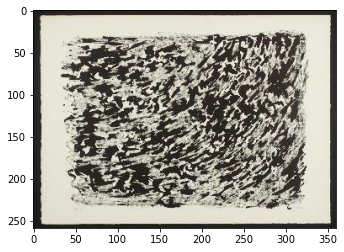

103_small.jpg


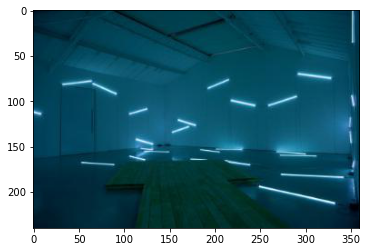

106_small.jpg


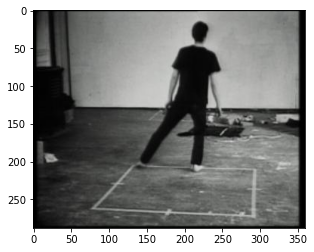

113_small.jpg


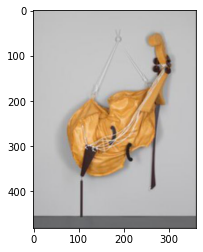

117_small.jpg


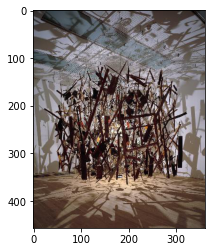

124_small.jpg


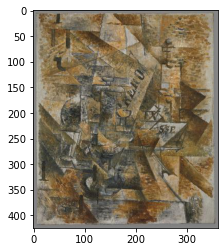

126_small.jpg


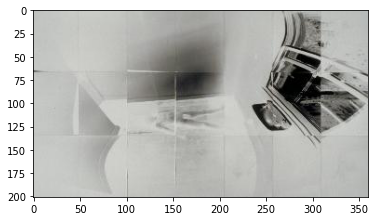

128_small.jpg


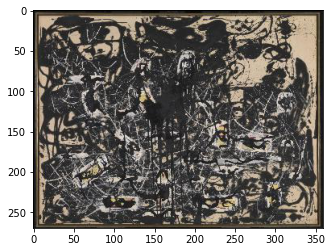

133_small.jpg


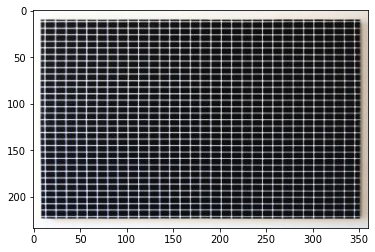

140_small.jpg


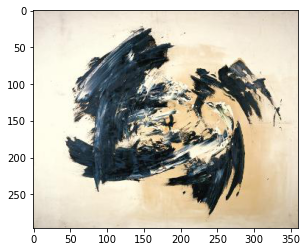

158_small.jpg


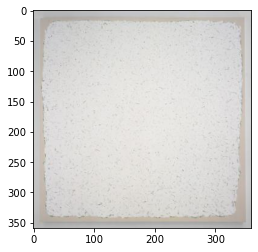

178_small.jpg


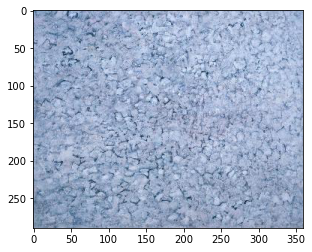

181_small.jpg


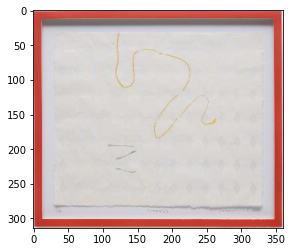

214_small.jpg


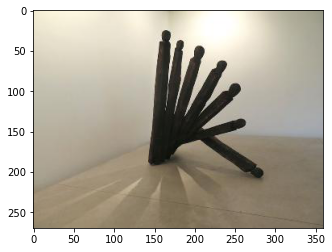

221_small.jpg


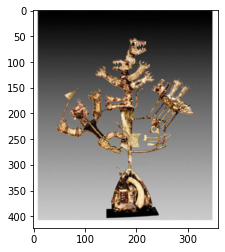

228_small.jpg


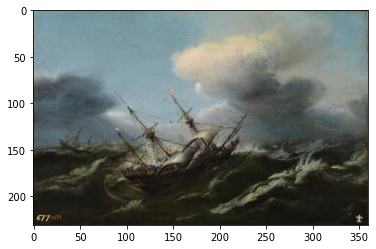

229_small.jpg


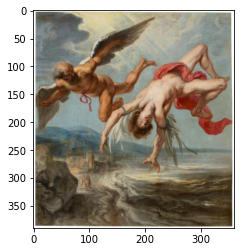

230_small.jpg


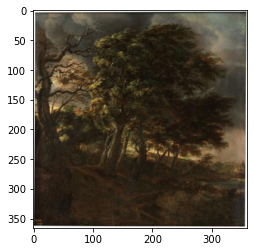

234_small.jpg


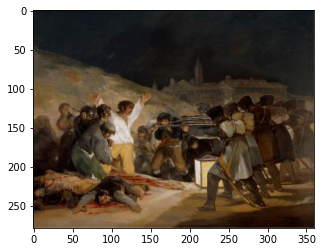

247_small.jpg


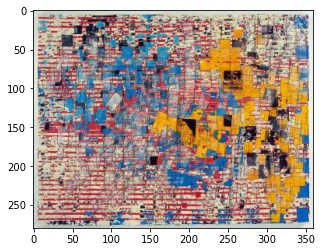

287_small.jpg


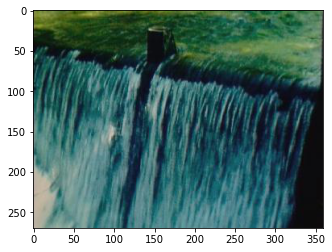

289_small.jpg


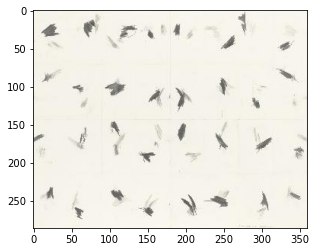

290_small.jpg


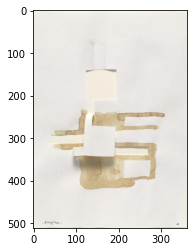

296_small.jpg


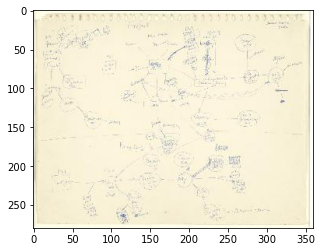

297_small.jpg


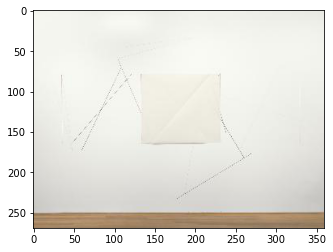

299_small.jpg


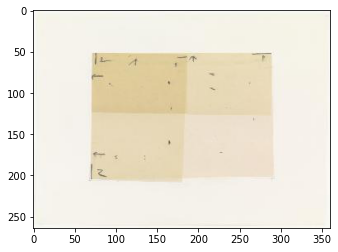

335_small.jpg


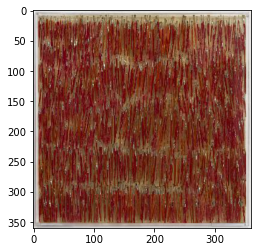

352_small.jpg


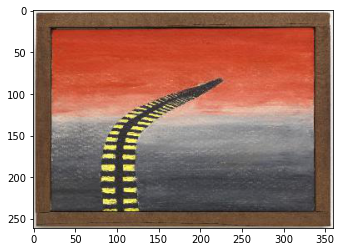

355_small.jpg


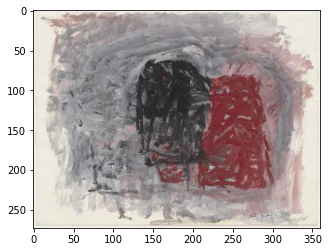

357_small.jpg


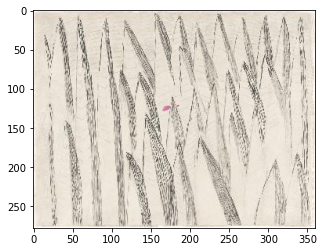

363_small.jpg


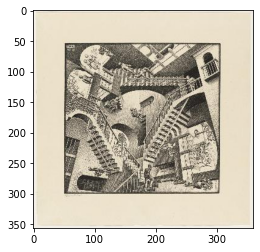

373_small.jpg


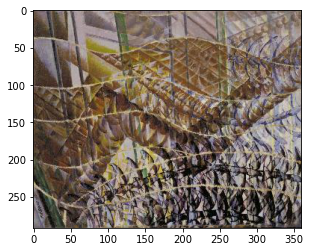

380_small.jpg


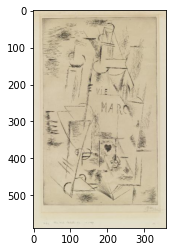

386_small.jpg


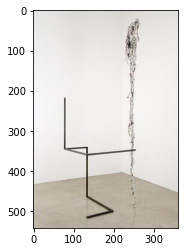

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 8
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
71_small.jpg


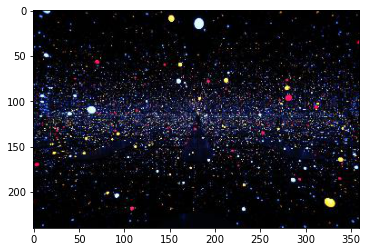

76_small.jpg


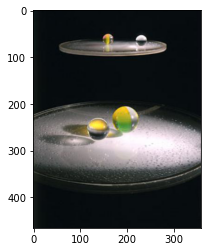

115_small.jpg


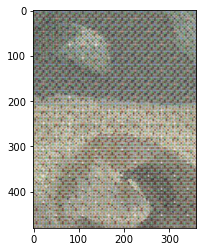

131_small.jpg


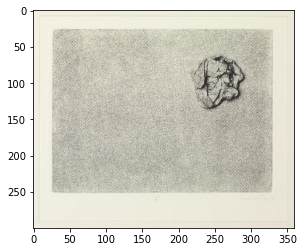

161_small.jpg


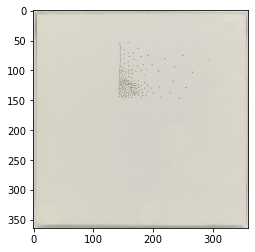

172_small.jpg


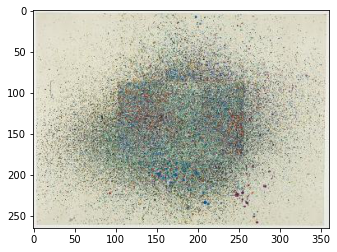

198_small.jpg


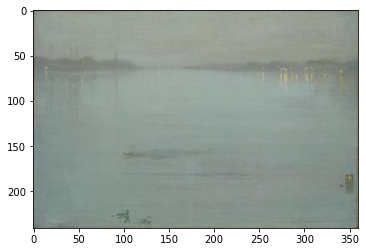

204_small.jpg


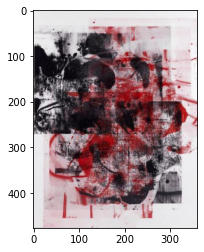

211_small.jpg


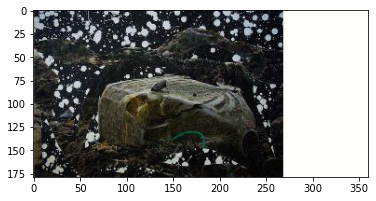

212_small.jpg


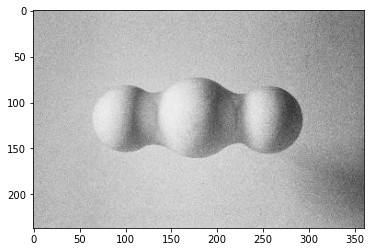

215_small.jpg


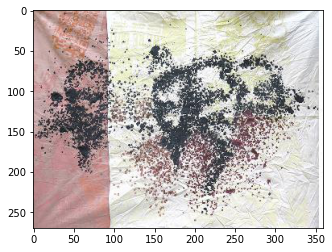

225_small.jpg


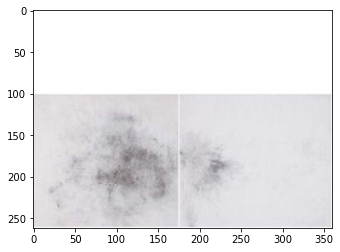

241_small.jpg


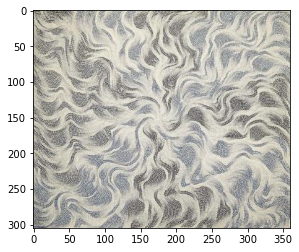

277_small.jpg


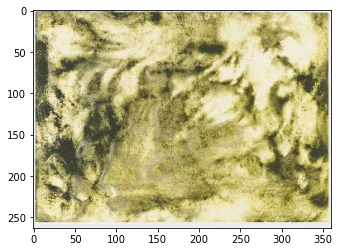

278_small.jpg


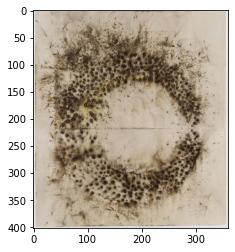

301_small.jpg


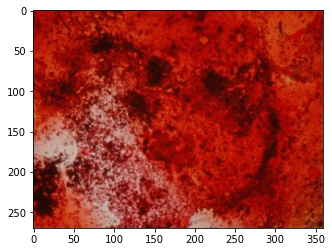

344_small.jpg


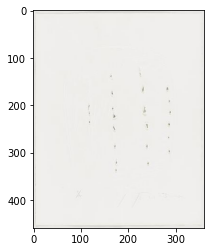

348_small.jpg


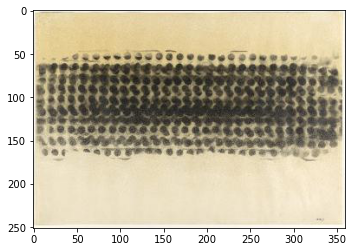

365_small.jpg


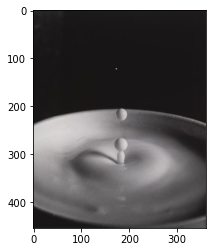

 
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
Images in cluster: 9
* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 
5_small.jpg


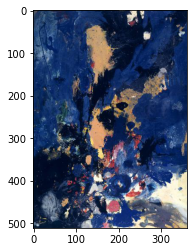

21_small.jpg


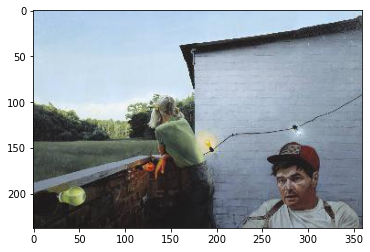

23_small.jpg


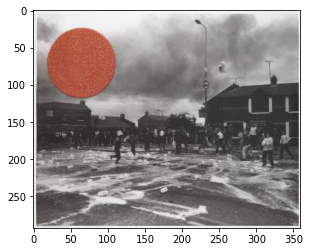

32_small.jpg


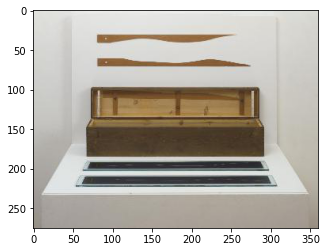

34_small.jpg


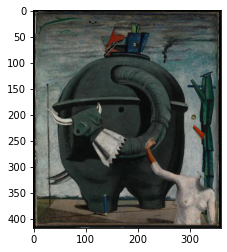

38_small.jpg


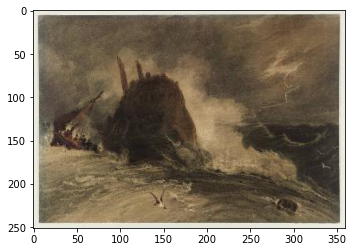

41_small.jpg


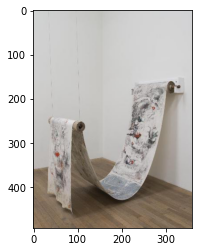

50_small.jpg


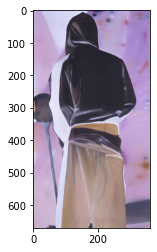

58_small.jpg


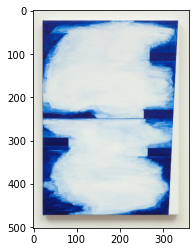

64_small.jpg


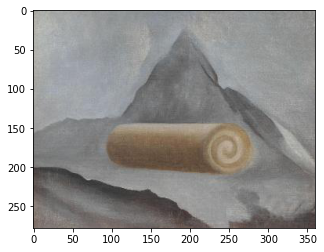

66_small.jpg


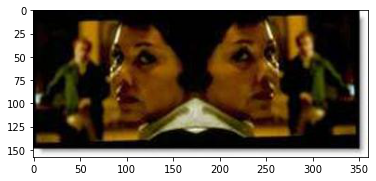

70_small.jpg


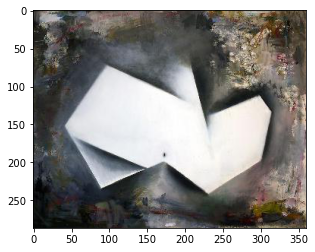

79_small.jpg


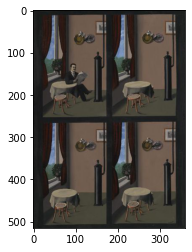

82_small.jpg


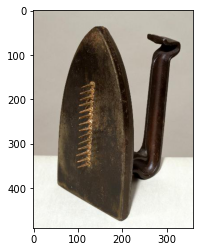

84_small.jpg


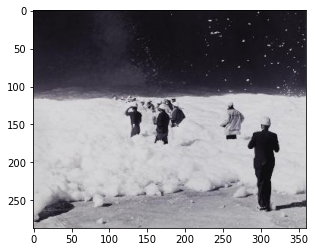

85_small.jpg


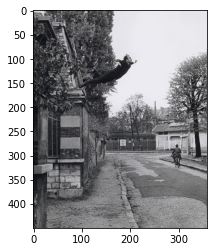

92_small.jpg


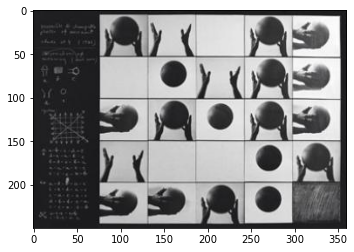

93_small.jpg


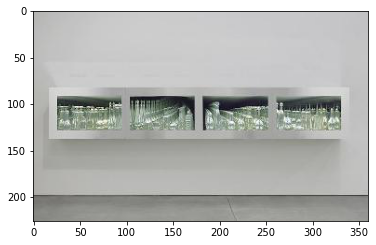

104_small.jpg


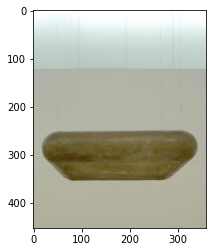

105_small.jpg


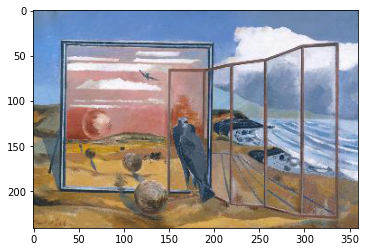

120_small.jpg


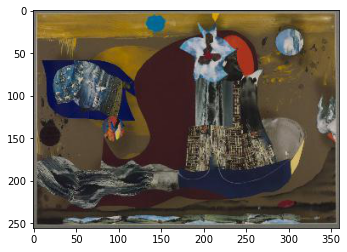

121_small.jpg


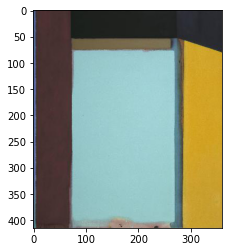

130_small.jpg


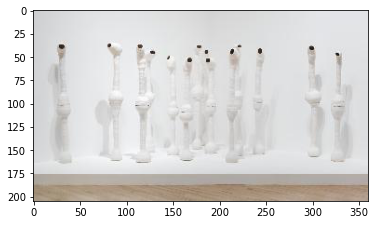

143_small.jpg


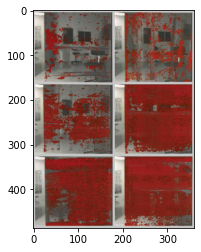

148_small.jpg


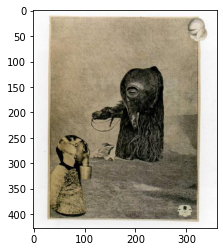

164_small.jpg


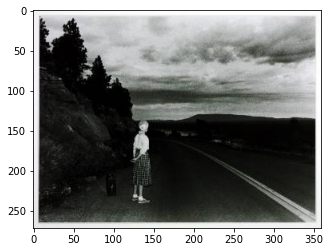

185_small.jpg


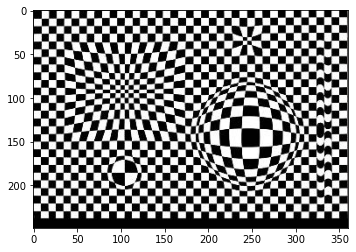

209_small.jpg


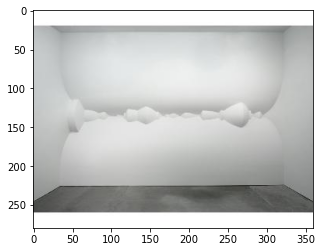

222_small.jpg


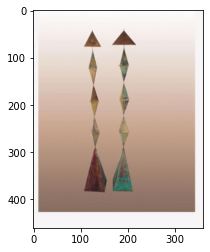

223_small.jpg


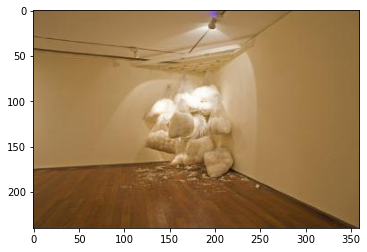

235_small.jpg


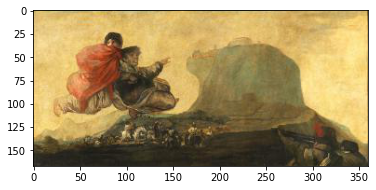

275_small.jpg


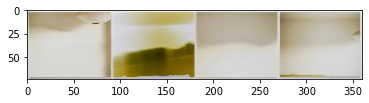

291_small.jpg


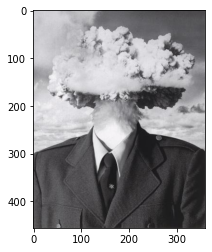

319_small.jpg


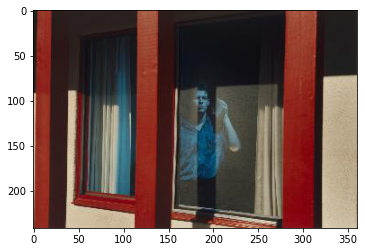

326_small.jpg


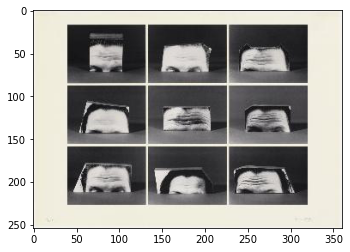

328_small.jpg


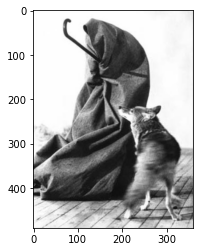

329_small.jpg


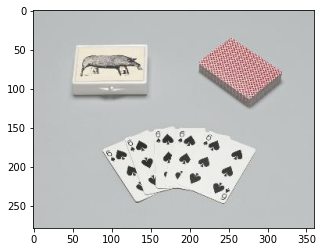

350_small.jpg


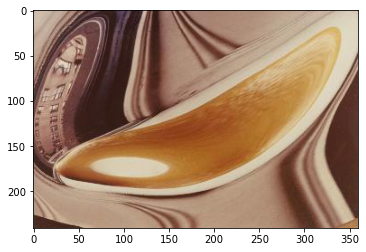

In [ ]:
ci_path = '/Users/ChantsTheRapper/Desktop/ML/A3/img_small/'

for i in range(0, max(km.labels_)+1):
    print(" ")
    print("* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * ")
    print("Images in cluster: " + str(i))
    print("* * * * * * * * * * * * * * * * * * * * * * * * * * * * * * ")
    for j in range(0, len(km.labels_)):
        if km.labels_[j] == i:
            txt = print(str(j+2) + '_small.jpg')
#             lookat = ci_path + str(j+2) + '_small.jpg'
            lookat = ci_path + str(j+2) + '_small.jpg'
            plt.figtext(0.5, -0.01, txt, wrap=True, horizontalalignment='center', fontsize=14); # orient text 
             # location of image            
            img_show = plt.imshow(io.imread(lookat)) # show image
            plt.show() # plot image(?)